In [1]:
import sys
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import miceforest as mf
from missforest.missforest import MissForest
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import calinski_harabasz_score
import geopandas



dados = pd.read_csv("HNP_StatsData.csv")
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125020 entries, 0 to 125019
Data columns (total 68 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country Name    125020 non-null  object 
 1   Country Code    125020 non-null  object 
 2   Indicator Name  125020 non-null  object 
 3   Indicator Code  125020 non-null  object 
 4   1960            41825 non-null   float64
 5   1961            42373 non-null   float64
 6   1962            42462 non-null   float64
 7   1963            42504 non-null   float64
 8   1964            42563 non-null   float64
 9   1965            42713 non-null   float64
 10  1966            42657 non-null   float64
 11  1967            42702 non-null   float64
 12  1968            42769 non-null   float64
 13  1969            42859 non-null   float64
 14  1970            44270 non-null   float64
 15  1971            44991 non-null   float64
 16  1972            45053 non-null   float64
 17  1973      

In [2]:
print("Python versão:", sys.version)
print("Pandas versão:", pd.__version__)
print("NumPy versão:", np.__version__)
print("Matplotlib versão:", matplotlib.__version__)
print("Seaborn versão:", sns.__version__)
print("Scikit Learn versão:", sklearn.__version__)
print("MICEForest versão:", mf.__version__)
print("Geopandas versão:", geopandas.__version__)


Python versão: 3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]
Pandas versão: 2.0.3
NumPy versão: 1.24.3
Matplotlib versão: 3.7.2
Seaborn versão: 0.12.2
Scikit Learn versão: 1.4.1.post1
MICEForest versão: 5.7.0
Geopandas versão: 0.13.2


In [3]:
dados

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,Unnamed: 67
0,Africa Eastern and Southern,AFE,"Adolescent fertility rate (births per 1,000 wo...",SP.ADO.TFRT,140.180526,140.810248,141.664168,142.324951,143.456933,144.33115,...,107.697715,105.501833,103.222825,100.963526,99.491703,99.085572,97.413585,96.181442,NaN,NaN
1,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (0-14 years) li...,SH.HIV.TOTL,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (ages 0-14) new...,SH.HIV.INCD.TL,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Africa Eastern and Southern,AFE,Adults (ages 15+) living with HIV,SH.DYN.AIDS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Africa Eastern and Southern,AFE,Adults (ages 15-49) newly infected with HIV,SH.HIV.INCD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125015,Zimbabwe,ZWE,Wanted fertility rate (births per woman),SP.DYN.WFRT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,3.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
125016,Zimbabwe,ZWE,Women who were first married by age 15 (% of w...,SP.M15.2024.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,3.700000,NaN,NaN,NaN,5.400000,NaN,NaN,NaN,NaN
125017,Zimbabwe,ZWE,Women who were first married by age 18 (% of w...,SP.M18.2024.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,32.400000,NaN,NaN,NaN,33.700000,NaN,NaN,NaN,NaN
125018,Zimbabwe,ZWE,Women's share of population ages 15+ living wi...,SH.DYN.AIDS.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,59.400000,59.500000,59.700000,59.900000,60.100000,60.300000,60.500000,60.700000,NaN,NaN


In [4]:
contagem = dados.iloc[:, :-1].count().sum()
porcentagem = (1 - (contagem/(125020*67)))*100
porcentagem

48.92388561113804

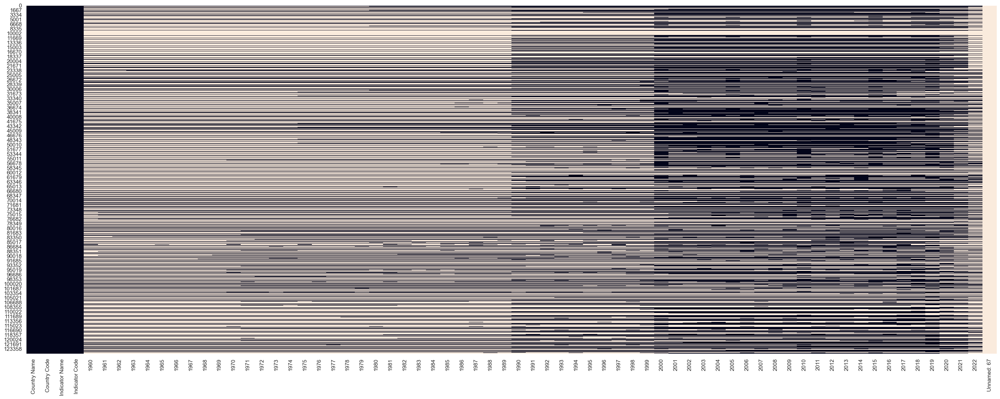

In [5]:
df = sns.set(rc={'figure.figsize': (35,15)})
df = sns.heatmap(dados.isna(), cbar = False)
df = plt.subplots_adjust(bottom=0.25, top=.9)
df

In [6]:
selecao_unicos = dados['Indicator Name'].unique()
selecao_unicos

array(['Adolescent fertility rate (births per 1,000 women ages 15-19)',
       'Adults (ages 15+) and children (0-14 years) living with HIV',
       'Adults (ages 15+) and children (ages 0-14) newly infected with HIV',
       'Adults (ages 15+) living with HIV',
       'Adults (ages 15-49) newly infected with HIV',
       'Age at first marriage, female', 'Age at first marriage, male',
       'Age dependency ratio (% of working-age population)',
       'Age dependency ratio, old', 'Age dependency ratio, young',
       'Age population, age 00, female, interpolated',
       'Age population, age 00, male, interpolated',
       'Age population, age 01, female, interpolated',
       'Age population, age 01, male, interpolated',
       'Age population, age 02, female, interpolated',
       'Age population, age 02, male, interpolated',
       'Age population, age 03, female, interpolated',
       'Age population, age 03, male, interpolated',
       'Age population, age 04, female, interpolated

In [7]:
print(len(selecao_unicos))

470


## Indicadores

In [8]:
selecao_geral = ["Birth rate, crude (per 1,000 people)",
# "Capital health expenditure (% of GDP)",
"Death rate, crude (per 1,000 people)",
"Domestic general government health expenditure (% of GDP)",
"GNI per capita, Atlas method (current US$)",
"Immunization, BCG (% of one-year-old children)",
"Immunization, DPT (% of children ages 12-23 months)",
"Immunization, HepB3 (% of one-year-old children)",
"Immunization, Hib3 (% of children ages 12-23 months)",
"Immunization, measles (% of children ages 12-23 months)",
"Immunization, measles second dose (% of children by the nationally recommended age)",
"Immunization, Pol3 (% of one-year-old children)",
# "Incidence of malaria (per 1,000 population at risk)",
"Incidence of tuberculosis (per 100,000 people)",
"Life expectancy at birth, total (years)",
"Low-birthweight babies (% of births)",
"Newborns protected against tetanus (%)",
# "Number of people who are undernourished",
"Number of under-five deaths",
"Population growth (annual %)",
# "Population, total",
"Public spending on education, total (% of GDP)",
"Prevalence of HIV, total (% of population ages 15-49)",
"Prevalence of hypertension (% of adults ages 30-79)",
"Prevalence of current tobacco use (% of adults)",
"Prevalence of undernourishment (% of population)",
"School enrollment, primary (% gross)",
"School enrollment, secondary (% gross)",
"School enrollment, tertiary (% gross)",
# "Sex ratio at birth (male births per female births)",
"Suicide mortality rate (per 100,000 population)",
"Tuberculosis case detection rate (%, all forms)",
"UHC service coverage index",
"Unemployment, total (% of total labor force)"
]

In [9]:
print(len(selecao_geral))

29


In [10]:
nova_selecao = [
#        'Adolescent fertility rate (births per 1,000 women ages 15-19)',
#        'Adults (ages 15+) and children (0-14 years) living with HIV',
#        'Adults (ages 15+) and children (ages 0-14) newly infected with HIV',
#        'Adults (ages 15+) living with HIV',
#        'Adults (ages 15-49) newly infected with HIV',
#        'Age at first marriage, female', 'Age at first marriage, male',
#        'Age dependency ratio (% of working-age population)',
#        'Age dependency ratio, old', 'Age dependency ratio, young',
#        'Age population, age 00, female, interpolated',
#        'Age population, age 00, male, interpolated',
#        'Age population, age 01, female, interpolated',
#        'Age population, age 01, male, interpolated',
#        'Age population, age 02, female, interpolated',
#        'Age population, age 02, male, interpolated',
#        'Age population, age 03, female, interpolated',
#        'Age population, age 03, male, interpolated',
#        'Age population, age 04, female, interpolated',
#        'Age population, age 04, male, interpolated',
#        'Age population, age 05, female, interpolated',
#        'Age population, age 05, male, interpolated',
#        'Age population, age 06, female, interpolated',
#        'Age population, age 06, male, interpolated',
#        'Age population, age 07, female, interpolated',
#        'Age population, age 07, male, interpolated',
#        'Age population, age 08, female, interpolated',
#        'Age population, age 08, male, interpolated',
#        'Age population, age 09, female, interpolated',
#        'Age population, age 09, male, interpolated',
#        'Age population, age 10, female, interpolated',
#        'Age population, age 10, male, interpolated',
#        'Age population, age 11, female, interpolated',
#        'Age population, age 11, male, interpolated',
#        'Age population, age 12, female, interpolated',
#        'Age population, age 12, male, interpolated',
#        'Age population, age 13, female, interpolated',
#        'Age population, age 13, male, interpolated',
#        'Age population, age 14, female, interpolated',
#        'Age population, age 14, male, interpolated',
#        'Age population, age 15, female, interpolated',
#        'Age population, age 15, male, interpolated',
#        'Age population, age 16, female, interpolated',
#        'Age population, age 16, male, interpolated',
#        'Age population, age 17, female, interpolated',
#        'Age population, age 17, male, interpolated',
#        'Age population, age 18, female, interpolated',
#        'Age population, age 18, male, interpolated',
#        'Age population, age 19, female, interpolated',
#        'Age population, age 19, male, interpolated',
#        'Age population, age 20, female, interpolated',
#        'Age population, age 20, male, interpolated',
#        'Age population, age 21, female, interpolated',
#        'Age population, age 21, male, interpolated',
#        'Age population, age 22, female, interpolated',
#        'Age population, age 22, male, interpolated',
#        'Age population, age 23, female, interpolated',
#        'Age population, age 23, male, interpolated',
#        'Age population, age 24, female, interpolated',
#        'Age population, age 24, male, interpolated',
#        'Age population, age 25, female, interpolated',
#        'Age population, age 25, male, interpolated',
       'AIDS estimated deaths (UNAIDS estimates)',
       'Antiretroviral therapy coverage (% of people living with HIV)',
       'Antiretroviral therapy coverage for PMTCT (% of pregnant women living with HIV)',
       'ARI treatment (% of children under 5 taken to a health provider)',
       'Birth rate, crude (per 1,000 people)',
       'Births attended by skilled health staff (% of total)',
       'Capital health expenditure (% of GDP)',
       'Cause of death, by communicable diseases and maternal, prenatal and nutrition conditions (% of total)',
       'Cause of death, by injury (% of total)',
       'Cause of death, by non-communicable diseases (% of total)',
       'Children (0-14) living with HIV',
       'Children (ages 0-14) newly infected with HIV',
       'Children orphaned by HIV/AIDS',
       'Children with fever receiving antimalarial drugs (% of children under age 5 with fever)',
       'Community health workers (per 1,000 people)',
       'Completeness of birth registration (%)',
#        'Completeness of birth registration, female (%)',
#        'Completeness of birth registration, male (%)',
#        'Completeness of birth registration, rural (%)',
#        'Completeness of birth registration, urban (%)',
       'Completeness of death registration with cause-of-death information (%)',
#        'Comprehensive correct knowledge of HIV/AIDS, ages 15-24, female (2 prevent ways and reject 3 misconceptions)',
#        'Comprehensive correct knowledge of HIV/AIDS, ages 15-24, male (2 prevent ways and reject 3 misconceptions)',
#        'Comprehensive correct knowledge of HIV/AIDS, ages 15-49, female (2 prevent ways and reject 3 misconceptions)',
#        'Comprehensive correct knowledge of HIV/AIDS, ages 15-49, male (2 prevent ways and reject 3 misconceptions)',
#        'Condom use at last high-risk sex, adult female (% ages 15-49)',
#        'Condom use at last high-risk sex, adult male (% ages 15-49)',
#        'Condom use, population ages 15-24, female (% of females ages 15-24)',
#        'Condom use, population ages 15-24, male (% of males ages 15-24)',
       'Consumption of iodized salt (% of households)',
#        'Contraceptive prevalence, any method (% of all women ages 15-49)',
#        'Contraceptive prevalence, any method (% of married women ages 15-49)',
#        'Contraceptive prevalence, any method (% of sexually active unmarried women ages 15-49)',
#        'Contraceptive prevalence, any modern method (% of all women ages 15-49)',
#        'Contraceptive prevalence, any modern method (% of married women ages 15-49)',
#        'Contraceptive prevalence, any modern method (% of sexually active unmarried women ages 15-49)',
       'Current health expenditure (% of GDP)',
#        'Current health expenditure per capita (current US$)',
#        'Current health expenditure per capita, PPP (current international $)',
       'Death rate, crude (per 1,000 people)',
#        'Demand for family planning satisfied by any methods (% of married women with demand for family planning)',
#        'Demand for family planning satisfied by modern methods (% of married women with demand for family planning)',
       'Diabetes prevalence (% of population ages 20 to 79)',
#        'Diarrhea treatment (% of children under 5 receiving oral rehydration and continued feeding)',
#        'Diarrhea treatment (% of children under 5 who received ORS packet)',
       'Domestic general government health expenditure (% of current health expenditure)',
#        'Domestic general government health expenditure (% of GDP)',
#        'Domestic general government health expenditure (% of general government expenditure)',
#        'Domestic general government health expenditure per capita (current US$)',
#        'Domestic general government health expenditure per capita, PPP (current international $)',
       'Domestic private health expenditure (% of current health expenditure)',
#        'Domestic private health expenditure per capita (current US$)',
#        'Domestic private health expenditure per capita, PPP  (current international $)',
       'Exclusive breastfeeding (% of children under 6 months)',
       'External health expenditure (% of current health expenditure)',
#        'External health expenditure channeled through government (% of external health expenditure)',
#        'External health expenditure per capita (current US$)',
#        'External health expenditure per capita, PPP (current international $)',
#        'Female headed households (% of households with a female head)',
#        'Fertility rate, total (births per woman)',
       'GNI per capita, Atlas method (current US$)',
       'Hospital beds (per 1,000 people)',
#        'Human capital index (HCI) (scale 0-1)',
#        'Human capital index (HCI), female (scale 0-1)',
#        'Human capital index (HCI), female, lower bound (scale 0-1)',
#        'Human capital index (HCI), female, upper bound (scale 0-1)',
#        'Human capital index (HCI), lower bound (scale 0-1)',
#        'Human capital index (HCI), male (scale 0-1)',
#        'Human capital index (HCI), male, lower bound (scale 0-1)',
#        'Human capital index (HCI), male, upper bound (scale 0-1)',
#        'Human capital index (HCI), upper bound (scale 0-1)',
       'Immunization, BCG (% of one-year-old children)',
       'Immunization, DPT (% of children ages 12-23 months)',
       'Immunization, HepB3 (% of one-year-old children)',
       'Immunization, Hib3 (% of children ages 12-23 months)',
       'Immunization, measles (% of children ages 12-23 months)',
       'Immunization, measles second dose (% of children by the nationally recommended age)',
       'Immunization, Pol3 (% of one-year-old children)',
#        'Incidence of HIV, ages 15-24 (per 1,000 uninfected population ages 15-24)',
#        'Incidence of HIV, ages 15-49 (per 1,000 uninfected population ages 15-49)',
#        'Incidence of HIV, ages 50+ (per 1,000 uninfected population ages 50+)',
       'Incidence of HIV, all (per 1,000 uninfected population)',
       'Incidence of malaria (per 1,000 population at risk)',
       'Incidence of tuberculosis (per 100,000 people)',
#        'Infant and young child feeding practices, all 3 IYCF (% children ages 6-23 months)',
#        'Intermittent preventive treatment (IPT) of malaria in pregnancy (% of pregnant women)',
#        'Labor force, female (% of total labor force)',
#        'Labor force, total', 'Life expectancy at birth, female (years)',
#        'Life expectancy at birth, male (years)',
#        'Life expectancy at birth, total (years)',
#        'Lifetime risk of maternal death (%)',
#        'Lifetime risk of maternal death (1 in: rate varies by country)',
#        'Literacy rate, adult female (% of females ages 15 and above)',
#        'Literacy rate, adult male (% of males ages 15 and above)',
#        'Literacy rate, adult total (% of people ages 15 and above)',
#        'Literacy rate, youth male (% of males ages 15-24)',
#        'Literacy rate, youth total (% of people ages 15-24)',
       'Low-birthweight babies (% of births)', 'Malaria cases reported',
#        'Maternal leave benefits (% of wages paid in covered period)',
#        'Maternal mortality ratio (modeled estimate, per 100,000 live births)',
       'Maternal mortality ratio (national estimate, per 100,000 live births)',
#        'Mortality caused by road traffic injury (per 100,000 people)',
#        'Mortality caused by road traffic injury, female (per 100,000 female population)',
#        'Mortality caused by road traffic injury, male (per 100,000 male population)',
       'Mortality from CVD, cancer, diabetes or CRD between exact ages 30 and 70 (%)',
#        'Mortality from CVD, cancer, diabetes or CRD between exact ages 30 and 70, female (%)',
#        'Mortality from CVD, cancer, diabetes or CRD between exact ages 30 and 70, male (%)',
       'Mortality rate attributed to household and ambient air pollution (per 100,000 population)',
#        'Mortality rate attributed to household and ambient air pollution, age-standardized, female (per 100,000 female population)',
#        'Mortality rate attributed to household and ambient air pollution, age-standardized, male (per 100,000 male population)',
       'Mortality rate attributed to unintentional poisoning (per 100,000 population)',
#        'Mortality rate attributed to unintentional poisoning, female (per 100,000 female population)',
#        'Mortality rate attributed to unintentional poisoning, male (per 100,000 male population)',
       'Mortality rate attributed to unsafe water, unsafe sanitation and lack of hygiene (per 100,000 population)',
#        'Mortality rate attributed to unsafe water, unsafe sanitation and lack of hygiene, female (per 100,000 female population)',
#        'Mortality rate attributed to unsafe water, unsafe sanitation and lack of hygiene, male (per 100,000 male population)',
#        'Mortality rate, adult, female (per 1,000 female adults)',
#        'Mortality rate, adult, male (per 1,000 male adults)',
       'Mortality rate, infant (per 1,000 live births)',
#        'Mortality rate, infant, female (per 1,000 live births)',
#        'Mortality rate, infant, male (per 1,000 live births)',
#        'Mortality rate, neonatal (per 1,000 live births)',
#        'Mortality rate, under-5 (per 1,000)',
#        'Mortality rate, under-5, female (per 1,000)',
#        'Mortality rate, under-5, male (per 1,000)',
#        'Net migration',
       'Newborns protected against tetanus (%)',
#        'Number of deaths ages 10-14 years',
#        'Number of deaths ages 10-14 years, female',
#        'Number of deaths ages 10-14 years, male',
#        'Number of deaths ages 10-19 years',
#        'Number of deaths ages 10-19 years, female',
#        'Number of deaths ages 10-19 years, male',
#        'Number of deaths ages 15-19 years',
#        'Number of deaths ages 15-19 years, female',
#        'Number of deaths ages 15-19 years, male',
#        'Number of deaths ages 20-24 years',
#        'Number of deaths ages 20-24 years, female',
#        'Number of deaths ages 20-24 years, male',
#        'Number of deaths ages 5-9 years',
#        'Number of deaths ages 5-9 years, female',
#        'Number of deaths ages 5-9 years, male', 
#         'Number of infant deaths',
#        'Number of infant deaths, female', 
#        'Number of infant deaths, male',
#        'Number of maternal deaths', 
#        'Number of neonatal deaths',
#        'Number of people pushed below the $2.15 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed below the $3.65 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed below the 60% median consumption poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed further below the $2.15 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed further below the $3.65 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed further below the 60% median consumption poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed or further pushed below the $2.15 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed or further pushed below the $3.65 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure',
#        'Number of people pushed or further pushed below the 60% median consumption poverty line by out-of-pocket health care expenditure',
#        'Number of people spending more than 10% of household consumption or income on out-of-pocket health care expenditure',
#        'Number of people spending more than 25% of household consumption or income on out-of-pocket health care expenditure',
       'Number of people who are undernourished', 
       'Number of stillbirths',
#        'Number of surgical procedures (per 100,000 population)',
       'Number of under-five deaths',
#        'Number of under-five deaths, female',
#        'Number of under-five deaths, male',
#        'Number of weeks of maternity leave',
       'Nurses and midwives (per 1,000 people)',
#        'Out-of-pocket expenditure (% of current health expenditure)',
#        'Out-of-pocket expenditure per capita (current US$)',
#        'Out-of-pocket expenditure per capita, PPP (current international $)',
       'People practicing open defecation (% of population)',
#        'People practicing open defecation, rural (% of rural population)',
#        'People practicing open defecation, urban (% of urban population)',
       'People using at least basic drinking water services (% of population)',
#        'People using at least basic drinking water services, rural (% of rural population)',
#        'People using at least basic drinking water services, urban (% of urban population)',
       'People using at least basic sanitation services (% of population)',
#        'People using at least basic sanitation services, rural (% of rural population)',
#        'People using at least basic sanitation services, urban  (% of urban population)',
       'People using safely managed drinking water services (% of population)',
#        'People using safely managed drinking water services, rural (% of rural population)',
#        'People using safely managed drinking water services, urban (% of urban population)',
       'People using safely managed sanitation services (% of population)',
#        'People using safely managed sanitation services, rural (% of rural population)',
#        'People using safely managed sanitation services, urban  (% of urban population)',
       'People with basic handwashing facilities including soap and water (% of population)',
#        'People with basic handwashing facilities including soap and water, rural (% of rural population)',
#        'People with basic handwashing facilities including soap and water, urban (% of urban population)',
       'Physicians (per 1,000 people)', 'Population ages 00-04, female',
#        'Population ages 00-04, female (% of female population)',
#        'Population ages 00-04, male',
#        'Population ages 00-04, male (% of male population)',
#        'Population ages 00-14, total',
#        'Population ages 0-14 (% of total population)',
#        'Population ages 0-14, female',
#        'Population ages 0-14, female (% of female population)',
#        'Population ages 0-14, male',
#        'Population ages 0-14, male (% of male population)',
#        'Population ages 05-09, female',
#        'Population ages 05-09, female (% of female population)',
#        'Population ages 05-09, male',
#        'Population ages 05-09, male (% of male population)',
#        'Population ages 10-14, female',
#        'Population ages 10-14, female (% of female population)',
#        'Population ages 10-14, male',
#        'Population ages 10-14, male (% of male population)',
#        'Population ages 15-19, female',
#        'Population ages 15-19, female (% of female population)',
#        'Population ages 15-19, male',
#        'Population ages 15-19, male (% of male population)',
#        'Population ages 15-64 (% of total population)',
#        'Population ages 15-64, female',
#        'Population ages 15-64, female (% of female population)',
#        'Population ages 15-64, male',
#        'Population ages 15-64, male (% of male population)',
#        'Population ages 15-64, total', 'Population ages 20-24, female',
#        'Population ages 20-24, female (% of female population)',
#        'Population ages 20-24, male',
#        'Population ages 20-24, male (% of male population)',
#        'Population ages 25-29, female',
#        'Population ages 25-29, female (% of female population)',
#        'Population ages 25-29, male',
#        'Population ages 25-29, male (% of male population)',
#        'Population ages 30-34, female',
#        'Population ages 30-34, female (% of female population)',
#        'Population ages 30-34, male',
#        'Population ages 30-34, male (% of male population)',
#        'Population ages 35-39, female',
#        'Population ages 35-39, female (% of female population)',
#        'Population ages 35-39, male',
#        'Population ages 35-39, male (% of male population)',
#        'Population ages 40-44, female',
#        'Population ages 40-44, female (% of female population)',
#        'Population ages 40-44, male',
#        'Population ages 40-44, male (% of male population)',
#        'Population ages 45-49, female',
#        'Population ages 45-49, female (% of female population)',
#        'Population ages 45-49, male',
#        'Population ages 45-49, male (% of male population)',
#        'Population ages 50-54, female',
#        'Population ages 50-54, female (% of female population)',
#        'Population ages 50-54, male',
#        'Population ages 50-54, male (% of male population)',
#        'Population ages 55-59, female',
#        'Population ages 55-59, female (% of female population)',
#        'Population ages 55-59, male',
#        'Population ages 55-59, male (% of male population)',
#        'Population ages 60-64, female',
#        'Population ages 60-64, female (% of female population)',
#        'Population ages 60-64, male',
#        'Population ages 60-64, male (% of male population)',
#        'Population ages 65 and above (% of total population)',
#        'Population ages 65 and above, female',
#        'Population ages 65 and above, female (% of female population)',
#        'Population ages 65 and above, male',
#        'Population ages 65 and above, male (% of male population)',
#        'Population ages 65 and above, total',
#        'Population ages 65-69, female',
#        'Population ages 65-69, female (% of female population)',
#        'Population ages 65-69, male',
#        'Population ages 65-69, male (% of male population)',
#        'Population ages 70-74, female',
#        'Population ages 70-74, female (% of female population)',
#        'Population ages 70-74, male',
#        'Population ages 70-74, male (% of male population)',
#        'Population ages 75-79, female',
#        'Population ages 75-79, female (% of female population)',
#        'Population ages 75-79, male',
#        'Population ages 75-79, male (% of male population)',
#        'Population ages 80 and above, female',
#        'Population ages 80 and above, male',
#        'Population ages 80 and above, male (% of male population)',
#        'Population ages 80 and older, female (% of female population)',
#        'Population growth (annual %)', 'Population, female',
#        'Population, female (% of total population)', 'Population, male',
#        'Population, male (% of total population)', 
#        'Population, total',
       'Postnatal care coverage (% mothers)',
#        'Poverty headcount ratio at national poverty line (% of population)',
       'Pregnant women receiving prenatal care (%)',
       'Pregnant women receiving prenatal care of at least four visits (% of pregnant women)',
       'Prevalence of anemia among children (% of children ages 6-59 months)',
       'Prevalence of anemia among non-pregnant women (% of women ages 15-49)',
       'Prevalence of anemia among pregnant women (%)',
#        'Prevalence of anemia among women of reproductive age (% of women ages 15-49)',
       'Prevalence of current tobacco use (% of adults)',
#        'Prevalence of current tobacco use, females (% of female adults)',
#        'Prevalence of current tobacco use, males (% of male adults)',
#        'Prevalence of HIV, female (% ages 15-24)',
#        'Prevalence of HIV, male (% ages 15-24)',
       'Prevalence of HIV, total (% of population ages 15-49)',
       'Prevalence of hypertension (% of adults ages 30-79)',
#        'Prevalence of hypertension, female (% of female adults ages 30-79)',
#        'Prevalence of hypertension, male (% of male adults ages 30-79)',
       'Prevalence of overweight (% of adults)',
       'Prevalence of overweight (% of children under 5)',
#        'Prevalence of overweight (modeled estimate, % of children under 5)',
#        'Prevalence of overweight, female (% of children under 5)',
#        'Prevalence of overweight, female (% of female adults)',
#        'Prevalence of overweight, male (% of children under 5)',
#        'Prevalence of overweight, male (% of male adults)',
       'Prevalence of severe wasting, weight for height (% of children under 5)',
#        'Prevalence of severe wasting, weight for height, female (% of children under 5)',
#        'Prevalence of severe wasting, weight for height, male (% of children under 5)',
       'Prevalence of stunting, height for age (% of children under 5)',
#        'Prevalence of stunting, height for age (modeled estimate, % of children under 5)',
#        'Prevalence of stunting, height for age, female (% of children under 5)',
#        'Prevalence of stunting, height for age, male (% of children under 5)',
       'Prevalence of syphilis (% of women attending antenatal care)',
       'Prevalence of undernourishment (% of population)',
       'Prevalence of underweight, weight for age (% of children under 5)',
#        'Prevalence of underweight, weight for age, female (% of children under 5)',
#        'Prevalence of underweight, weight for age, male (% of children under 5)',
       'Prevalence of wasting, weight for height (% of children under 5)',
#        'Prevalence of wasting, weight for height, female (% of children under 5)',
#        'Prevalence of wasting, weight for height, male (% of children under 5)',
#        'Primary completion rate, female (% of relevant age group)',
#        'Primary completion rate, male (% of relevant age group)',
#        'Primary completion rate, total (% of relevant age group)',
#        'Probability of dying among adolescents ages 10-14 years (per 1,000)',
#        'Probability of dying among adolescents ages 10-14 years, female (per 1,000)',
#        'Probability of dying among adolescents ages 10-14 years, male (per 1,000)',
#        'Probability of dying among adolescents ages 10-19 years (per 1,000)',
#        'Probability of dying among adolescents ages 10-19 years, female (per 1,000)',
#        'Probability of dying among adolescents ages 10-19 years, male (per 1,000)',
#        'Probability of dying among adolescents ages 15-19 years (per 1,000)',
#        'Probability of dying among adolescents ages 15-19 years, female (per 1,000)',
#        'Probability of dying among adolescents ages 15-19 years, male (per 1,000)',
#        'Probability of dying among children ages 5-9 years (per 1,000)',
#        'Probability of dying among children ages 5-9 years, female (per 1,000)',
#        'Probability of dying among children ages 5-9 years, male (per 1,000)',
#        'Probability of dying among youth ages 20-24 years (per 1,000)',
#        'Probability of dying among youth ages 20-24 years, female (per 1,000)',
#        'Probability of dying among youth ages 20-24 years, male (per 1,000)',
#        'Proportion of population pushed below the $2.15 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed below the $3.65 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed below the 60% median consumption poverty line by out-of-pocket health expenditure (%)',
#        'Proportion of population pushed further below the $2.15 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed further below the $3.65 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed further below the 60% median consumption poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed or further pushed below the $2.15 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed or further pushed below the $3.65 ($ 2017 PPP) poverty line by out-of-pocket health care expenditure (%)',
#        'Proportion of population pushed or further pushed below the 60% median consumption poverty line by out-of-pocket health expenditure (%)',
#        'Proportion of population spending more than 10% of household consumption or income on out-of-pocket health care expenditure (%)',
#        'Proportion of population spending more than 25% of household consumption or income on out-of-pocket health care expenditure (%)',
#        'Public spending on education, total (% of GDP)',
#        'Ratio of school attendance of orphans to school attendance of non-orphans ages 10-14',
#        'Ratio of young literate females to males (% ages 15-24)',
#        'Risk of catastrophic expenditure for surgical care (% of people at risk)',
#        'Risk of impoverishing expenditure for surgical care (% of people at risk)',
#        'Rural population', 'Rural population (% of total population)',
#        'Rural population growth (annual %)',
#        'Rural poverty headcount ratio at national poverty lines (% of rural population)',
#        'School enrollment, primary (% gross)',
#        'School enrollment, primary (% net)',
#        'School enrollment, primary, female (% gross)',
#        'School enrollment, primary, female (% net)',
#        'School enrollment, primary, male (% gross)',
#        'School enrollment, primary, male (% net)',
#        'School enrollment, secondary (% gross)',
#        'School enrollment, secondary (% net)',
#        'School enrollment, secondary, female (% gross)',
#        'School enrollment, secondary, female (% net)',
#        'School enrollment, secondary, male (% gross)',
#        'School enrollment, secondary, male (% net)',
#        'School enrollment, tertiary (% gross)',
#        'School enrollment, tertiary, female (% gross)',
#        'Sex ratio at birth (male births per female births)',
#        'Share of women employed in the nonagricultural sector (% of total nonagricultural employment)',
       'Specialist surgical workforce (per 100,000 population)',
       'Stillbirth rate (per 1,000 total births)',
       'Suicide mortality rate (per 100,000 population)',
#        'Suicide mortality rate, female (per 100,000 female population)',
#        'Suicide mortality rate, male (per 100,000 male population)',
#        'Survival to age 65, female (% of cohort)',
#        'Survival to age 65, male (% of cohort)',
#        'Teenage mothers (% of women ages 15-19 who have had children or are currently pregnant)',
       'Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)',
#        'Total alcohol consumption per capita, female (liters of pure alcohol, projected estimates, female 15+ years of age)',
#        'Total alcohol consumption per capita, male (liters of pure alcohol, projected estimates, male 15+ years of age)',
       'Treatment for hypertension (% of adults ages 30-79 with hypertension)',
#        'Treatment for hypertension, female (% of female adults ages 30-79 with hypertension)',
#        'Treatment for hypertension, male (% of male adults ages 30-79 with hypertension)',
#        'Tuberculosis case detection rate (%, all forms)',
       'Tuberculosis death rate (per 100,000 people)',
#        'Tuberculosis treatment success rate (% of new cases)',
       'UHC service coverage index',
#        'Unemployment, female (% of female labor force)',
#        'Unemployment, male (% of male labor force)',
#        'Unemployment, total (% of total labor force)',
#        'Unmet need for contraception (% of married women ages 15-49)',
#        'Urban population', 'Urban population (% of total population)',
#        'Urban population growth (annual %)',
#        'Urban poverty headcount ratio at national poverty lines (% of urban population)',
#        'Use of insecticide-treated bed nets (% of under-5 population)',
       'Vitamin A supplementation coverage rate (% of children ages 6-59 months)',
#        'Wanted fertility rate (births per woman)',
#        'Women who were first married by age 15 (% of women ages 20-24)',
#        'Women who were first married by age 18 (% of women ages 20-24)',
#        "Women's share of population ages 15+ living with HIV (%)",
#        'Young people (ages 15-24) newly infected with HIV'
               ]

In [11]:
print(len(nova_selecao))

83


## Base de Dados 2019

In [12]:
info_2019 = ["Country Name", "Country Code", "Indicator Name", "2019"]
data_2019 = dados[info_2019]
data_2019

,Country Name,Country Code,Indicator Name,2019
0,Africa Eastern and Southern,AFE,"Adolescent fertility rate (births per 1,000 wo...",99.085572
1,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (0-14 years) li...,NaN
2,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (ages 0-14) new...,NaN
3,Africa Eastern and Southern,AFE,Adults (ages 15+) living with HIV,NaN
4,Africa Eastern and Southern,AFE,Adults (ages 15-49) newly infected with HIV,NaN
...,...,...,...,...
125015,Zimbabwe,ZWE,Wanted fertility rate (births per woman),NaN
125016,Zimbabwe,ZWE,Women who were first married by age 15 (% of w...,5.400000
125017,Zimbabwe,ZWE,Women who were first married by age 18 (% of w...,33.700000
125018,Zimbabwe,ZWE,Women's share of population ages 15+ living wi...,60.300000


In [13]:
#OLHAR AQUI A SELECAO DE INDICADORES
indicadores_2019 = data_2019["Indicator Name"].isin(selecao_geral)
ind_2019 = data_2019[indicadores_2019]
ind_2019_ano = ind_2019["2019"]
df_2019 = pd.DataFrame(ind_2019_ano)
df_2019.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7714 entries, 66 to 125007
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   2019    6353 non-null   float64
dtypes: float64(1)
memory usage: 120.5 KB


In [14]:
info_geral = ["Country Name", "Country Code", "Indicator Name", "2019"]
data_geral = dados[info_geral]
data_geral

,Country Name,Country Code,Indicator Name,2019
0,Africa Eastern and Southern,AFE,"Adolescent fertility rate (births per 1,000 wo...",99.085572
1,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (0-14 years) li...,NaN
2,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (ages 0-14) new...,NaN
3,Africa Eastern and Southern,AFE,Adults (ages 15+) living with HIV,NaN
4,Africa Eastern and Southern,AFE,Adults (ages 15-49) newly infected with HIV,NaN
...,...,...,...,...
125015,Zimbabwe,ZWE,Wanted fertility rate (births per woman),NaN
125016,Zimbabwe,ZWE,Women who were first married by age 15 (% of w...,5.400000
125017,Zimbabwe,ZWE,Women who were first married by age 18 (% of w...,33.700000
125018,Zimbabwe,ZWE,Women's share of population ages 15+ living wi...,60.300000


In [15]:
indicadores_gerais = data_geral["Indicator Name"].isin(selecao_geral)
ind_geral = data_geral[indicadores_gerais]
df_geral = pd.DataFrame(ind_geral)
df_geral.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7714 entries, 66 to 125007
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country Name    7714 non-null   object 
 1   Country Code    7714 non-null   object 
 2   Indicator Name  7714 non-null   object 
 3   2019            6353 non-null   float64
dtypes: float64(1), object(3)
memory usage: 301.3+ KB


In [16]:
paises = dados["Country Name"].unique()
paises_limpo = ['Africa Eastern and Southern',
                            'Africa Western and Central',
                            'Arab World', 
                            'Caribbean small states',
                            'Central Europe and the Baltics', 
                            'Early-demographic dividend',
                            'East Asia & Pacific',
                            'East Asia & Pacific (excluding high income)',
                            'East Asia & Pacific (IDA & IBRD countries)', 
                            'Euro area',
                            'Europe & Central Asia',
                            'Europe & Central Asia (excluding high income)',
                            'Europe & Central Asia (IDA & IBRD countries)', 
                            'European Union',
                            'Fragile and conflict affected situations',
                            'Heavily indebted poor countries (HIPC)', 
                            'High income',
                            'IBRD only', 
                            'IDA & IBRD total', 
                            'IDA blend', 
                            'IDA only',
                            'IDA total', 
                            'Late-demographic dividend',
                            'Latin America & Caribbean',
                            'Latin America & Caribbean (excluding high income)',
                            'Latin America & the Caribbean (IDA & IBRD countries)',
                            'Least developed countries: UN classification',
                            'Low & middle income', 
                            'Low income', 
                            'Lower middle income',
                            'Middle East & North Africa',
                            'Middle East & North Africa (excluding high income)',
                            'Middle East & North Africa (IDA & IBRD countries)',
                            'Middle income', 
                            'North America', 'Not classified', 
                            'OECD members',
                            'Other small states', 
                            'Pacific island small states',
                            'Post-demographic dividend', 
                            'Pre-demographic dividend',
                            'Small states', 
                            'South Asia', 
                            'South Asia (IDA & IBRD)',
                            'Sub-Saharan Africa', 
                            'Sub-Saharan Africa (excluding high income)',
                            'Sub-Saharan Africa (IDA & IBRD countries)', 
                            'Upper middle income',
                            'World'
                           ]

In [17]:
print(len(paises_limpo))

49


In [18]:
relatorio = list()
for pais in paises:
    linha_relatorio = [pais]
    for indicador in selecao_geral:
        df_temp = dados[(dados["Country Name"] == pais) & (dados["Indicator Name"] == indicador)]
        valor = df_temp.iloc[0]["2019"]
        linha_relatorio.append(valor)
    relatorio.append(linha_relatorio)

In [19]:
colunas = ["Pais"]
colunas.extend(selecao_geral)
df_ind_2019 = pd.DataFrame(relatorio, columns=colunas)
# df_ind_2019.head()
# df_ind_2019.to_excel("Dados_2019.xlsx")

In [20]:
# df_ind_2019.dropna(axis=1,thresh=200, inplace=True)
df_ind_2019

,Pais,"Birth rate, crude (per 1,000 people)","Death rate, crude (per 1,000 people)",Domestic general government health expenditure (% of GDP),"GNI per capita, Atlas method (current US$)","Immunization, BCG (% of one-year-old children)","Immunization, DPT (% of children ages 12-23 months)","Immunization, HepB3 (% of one-year-old children)","Immunization, Hib3 (% of children ages 12-23 months)","Immunization, measles (% of children ages 12-23 months)",...,Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),"School enrollment, primary (% gross)","School enrollment, secondary (% gross)","School enrollment, tertiary (% gross)","Suicide mortality rate (per 100,000 population)","Tuberculosis case detection rate (%, all forms)",UHC service coverage index,"Unemployment, total (% of total labor force)"
0,Africa Eastern and Southern,34.341450,7.434644,2.789083,1503.605834,82.771314,79.492581,79.493213,79.493213,74.861776,...,35.079081,12.451462,24.374440,105.208809,43.437199,8.809290,8.024906,NaN,NaN,7.121663
1,Africa Western and Central,37.027834,10.488748,0.752566,1703.266895,79.664316,72.257344,72.258016,72.258016,65.751765,...,36.455108,6.352941,12.824235,89.480888,44.295570,9.889590,5.420255,NaN,NaN,4.261414
2,Arab World,24.598620,5.198866,2.595131,6462.604768,86.427148,86.180941,86.144765,86.199008,84.731789,...,38.019182,20.690081,12.041850,90.339828,68.888496,33.018421,4.162428,NaN,NaN,10.165158
3,Caribbean small states,13.931756,7.485220,3.375015,10110.971677,NaN,93.502882,93.556556,93.556556,92.083605,...,43.625486,NaN,7.648140,97.681824,89.076767,NaN,10.047851,NaN,NaN,6.844145
4,Central Europe and the Baltics,9.909592,11.981800,4.967848,15930.551660,88.483986,94.058794,82.337418,93.999646,93.171442,...,47.177888,29.083999,2.524278,95.518440,99.793823,64.556793,12.521257,NaN,NaN,3.780901
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,Virgin Islands (U.S.),12.300000,8.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.350000
262,West Bank and Gaza,29.466000,3.225000,NaN,4270.000000,99.000000,99.000000,99.000000,99.000000,99.000000,...,39.100000,NaN,NaN,96.062424,88.887833,45.354912,NaN,80.0,NaN,25.340000
263,"Yemen, Rep.",31.778000,6.416000,NaN,NaN,69.000000,73.000000,73.000000,73.000000,67.000000,...,29.300000,20.500000,38.900000,NaN,NaN,NaN,5.800000,68.0,42.0,12.978000
264,Zambia,35.462000,6.571000,2.136501,1390.000000,95.000000,88.000000,88.000000,88.000000,93.000000,...,32.300000,14.600000,29.200000,96.249168,NaN,NaN,7.300000,59.0,54.0,5.540000


In [21]:
df_ind_2019.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 30 columns):
 #   Column                                                                               Non-Null Count  Dtype  
---  ------                                                                               --------------  -----  
 0   Pais                                                                                 266 non-null    object 
 1   Birth rate, crude (per 1,000 people)                                                 259 non-null    float64
 2   Death rate, crude (per 1,000 people)                                                 259 non-null    float64
 3   Domestic general government health expenditure (% of GDP)                            230 non-null    float64
 4   GNI per capita, Atlas method (current US$)                                           244 non-null    float64
 5   Immunization, BCG (% of one-year-old children)                                       191 non

In [22]:
contagem = df_ind_2019.count().sum()
porcentagem = (1 - (contagem/(266*30)))*100
porcentagem

17.055137844611533

## 2020

In [23]:
# relatorio = list()
# for pais in paises:
#     linha_relatorio = [pais]
#     for indicador in selecao_geral:
#         df_temp = dados[(dados["Country Name"] == pais) & (dados["Indicator Name"] == indicador)]
#         valor = df_temp.iloc[0]["2020"]
#         linha_relatorio.append(valor)
#     relatorio.append(linha_relatorio)

In [24]:
# colunas = ["Pais"]
# colunas.extend(selecao_geral)
# df_ind_2020 = pd.DataFrame(relatorio, columns=colunas)
# df_ind_2020.head()
# df_ind_2020.to_excel("Dados_2020.xlsx")

In [25]:
# df_ind_2020

In [26]:
# df_ind_2020.info()

In [27]:
# contagem = df_ind_2020.count().sum()
# porcentagem = (1 - (contagem/(266*30)))*100
# porcentagem

## 2021

In [28]:
# relatorio = list()
# for pais in paises:
#     linha_relatorio = [pais]
#     for indicador in selecao_geral:
#         df_temp = dados[(dados["Country Name"] == pais) & (dados["Indicator Name"] == indicador)]
#         valor = df_temp.iloc[0]["2021"]
#         linha_relatorio.append(valor)
#     relatorio.append(linha_relatorio)

In [29]:
# colunas = ["Pais"]
# colunas.extend(selecao_geral)
# df_ind_2021 = pd.DataFrame(relatorio, columns=colunas)
# df_ind_2021.head()
# df_ind_2021.to_excel("Dados_2021.xlsx")

In [30]:
# df_ind_2021

In [31]:
# df_ind_2021.info()

In [32]:
# contagem = df_ind_2021.count().sum()
# porcentagem = (1 - (contagem/(266*30)))*100
# porcentagem

## 2022

In [33]:
# relatorio = list()
# for pais in paises:
#     linha_relatorio = [pais]
#     for indicador in selecao_geral:
#         df_temp = dados[(dados["Country Name"] == pais) & (dados["Indicator Name"] == indicador)]
#         valor = df_temp.iloc[0]["2022"]
#         linha_relatorio.append(valor)
#     relatorio.append(linha_relatorio)

In [34]:
# colunas = ["Pais"]
# colunas.extend(selecao_geral)
# df_ind_2022 = pd.DataFrame(relatorio, columns=colunas)
# df_ind_2022.head()
# df_ind_2022.to_excel("Dados_2022.xlsx")

In [35]:
# df_ind_2022

In [36]:
# df_ind_2021.info()

In [37]:
# contagem = df_ind_2022.count().sum()
# porcentagem = (1 - (contagem/(266*30)))*100
# porcentagem

## Inicio Método

In [38]:
scaler = MinMaxScaler()
minmax = scaler.fit_transform(df_ind_2019.iloc[:, 1:])
df_norm_2019 = pd.DataFrame(data=minmax, columns=df_ind_2019.iloc[:, 1:].columns)
df_norm_2019.head()

,"Birth rate, crude (per 1,000 people)","Death rate, crude (per 1,000 people)",Domestic general government health expenditure (% of GDP),"GNI per capita, Atlas method (current US$)","Immunization, BCG (% of one-year-old children)","Immunization, DPT (% of children ages 12-23 months)","Immunization, HepB3 (% of one-year-old children)","Immunization, Hib3 (% of children ages 12-23 months)","Immunization, measles (% of children ages 12-23 months)","Immunization, measles second dose (% of children by the nationally recommended age)",...,Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),"School enrollment, primary (% gross)","School enrollment, secondary (% gross)","School enrollment, tertiary (% gross)","Suicide mortality rate (per 100,000 population)","Tuberculosis case detection rate (%, all forms)",UHC service coverage index,"Unemployment, total (% of total labor force)"
0,0.711766,0.444114,0.156364,0.010881,0.836074,0.695197,0.695206,0.718452,0.634269,0.390939,...,0.402775,0.194111,0.442802,0.550699,0.165524,0.041510,0.105901,NaN,NaN,0.267849
1,0.778994,0.654611,0.022691,0.012587,0.804690,0.582146,0.582157,0.614025,0.496239,0.176902,...,0.441320,0.060372,0.208993,0.390333,0.171852,0.049262,0.069726,NaN,NaN,0.158742
2,0.467945,0.290018,0.143633,0.053247,0.873001,0.799702,0.799137,0.815239,0.783815,0.762746,...,0.485131,0.374782,0.193155,0.399091,0.353146,0.215222,0.052256,NaN,NaN,0.383947
3,0.201000,0.447599,0.194824,0.084417,NaN,0.914108,0.914946,0.921433,0.895206,0.849702,...,0.642170,NaN,0.104213,0.473952,0.501971,NaN,0.133998,NaN,NaN,0.257263
4,0.100343,0.757516,0.299374,0.134135,0.893778,0.922794,0.739647,0.927828,0.911689,0.901363,...,0.741678,0.558860,0.000491,0.451893,0.580975,0.441524,0.168351,NaN,NaN,0.140412


In [39]:
pd.set_option('display.max_columns', None)
paises_sem_grupo = [x for x in paises if x not in paises_limpo]
# paises_sem_grupo

In [40]:
df_mundo = df_norm_2019[df_ind_2019['Pais'].isin(paises_sem_grupo)]
df_mundo1 = df_mundo.copy()
df_mundo1.columns = df_mundo1.columns.str.replace(',', '')
df_mundo1.columns = df_mundo1.columns.str.replace(':', '')
df_mundo1

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,NaN,0.200,1.506658e-02,0.850384,NaN,0.000000,0.546218,0.442982,0.493927,0.599628,NaN,NaN,0.051389,0.571429,0.246154,0.419035
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,NaN,0.367107,0.029167,0.654762,0.738462,0.396529
52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.003670,NaN,NaN,NaN,NaN,0.087891,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.726190,NaN,NaN
53,0.027528,0.200496,0.321697,0.395557,NaN,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,NaN,0.228047,NaN,3.735038e-07,0.682014,0.216481,NaN,0.288515,0.622807,NaN,0.389028,0.550678,0.085932,NaN,0.726190,0.800000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,0.160164,0.496864,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.829188,NaN,NaN,NaN,0.379477,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.467290
262,0.589754,0.153973,NaN,0.034515,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000810,0.691994,0.267563,NaN,4.297161e-04,0.792349,NaN,NaN,0.515406,NaN,NaN,0.457440,0.500578,0.303742,NaN,0.642857,NaN,0.962808
263,0.647614,0.373906,NaN,NaN,0.696970,0.593750,0.593750,0.624734,0.515152,0.442105,0.438596,0.073394,0.377497,NaN,0.250,1.136441e-02,0.779832,NaN,0.000000,0.240896,0.370614,0.736842,NaN,NaN,NaN,0.075000,0.500000,0.246154,0.491245
264,0.739808,0.384589,0.113530,0.009910,0.959596,0.828125,0.828125,0.841234,0.909091,0.652632,0.824561,0.509174,0.306255,0.312237,0.625,7.432912e-03,0.864878,0.311767,0.396552,0.324930,0.241228,0.540486,0.459344,NaN,NaN,0.095833,0.392857,0.430769,0.207515


## MICEForest

In [41]:
#Kernel
kds = mf.ImputationKernel(df_mundo1, save_all_iterations=True, random_state=42)

kds.mice(50)

#df_completa
df_completa = kds.complete_data()
df_completa

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,0.160164,0.496864,0.438966,0.206664,0.979798,0.953125,0.937500,0.942267,0.939394,0.936842,0.947368,0.011009,0.829188,0.139646,0.875,7.133922e-05,0.379477,0.425588,0.017241,0.680672,0.728070,0.000000,0.550246,0.728814,0.652785,0.198611,0.750000,0.876923,0.467290
262,0.589754,0.153973,0.282585,0.034515,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000810,0.691994,0.267563,0.875,4.297161e-04,0.792349,0.365591,0.234483,0.515406,0.372807,0.091093,0.457440,0.500578,0.303742,0.147222,0.642857,0.661538,0.962808
263,0.647614,0.373906,0.037974,0.003076,0.696970,0.593750,0.593750,0.624734,0.515152,0.442105,0.438596,0.073394,0.377497,0.615766,0.250,1.136441e-02,0.779832,0.112547,0.000000,0.240896,0.370614,0.736842,0.779642,0.067012,0.018009,0.075000,0.500000,0.246154,0.491245
264,0.739808,0.384589,0.113530,0.009910,0.959596,0.828125,0.828125,0.841234,0.909091,0.652632,0.824561,0.509174,0.306255,0.312237,0.625,7.432912e-03,0.864878,0.311767,0.396552,0.324930,0.241228,0.540486,0.459344,0.147667,0.021769,0.095833,0.392857,0.430769,0.207515


In [42]:
# df_completa.info()

## Kmeans

In [43]:
import warnings
warnings.filterwarnings('ignore')
wcss = list()

for i in range(1,10):
    kmeans = KMeans(n_clusters=i, random_state=5)
    kmeans.fit(df_completa)
    wcss.append(kmeans.inertia_)


[233.73965552891946, 154.83209280545339, 136.63613279017864, 117.20621800798853, 105.64308130959353, 98.38532178422828, 95.24753261380104, 90.20018973083286, 86.65935113986549]


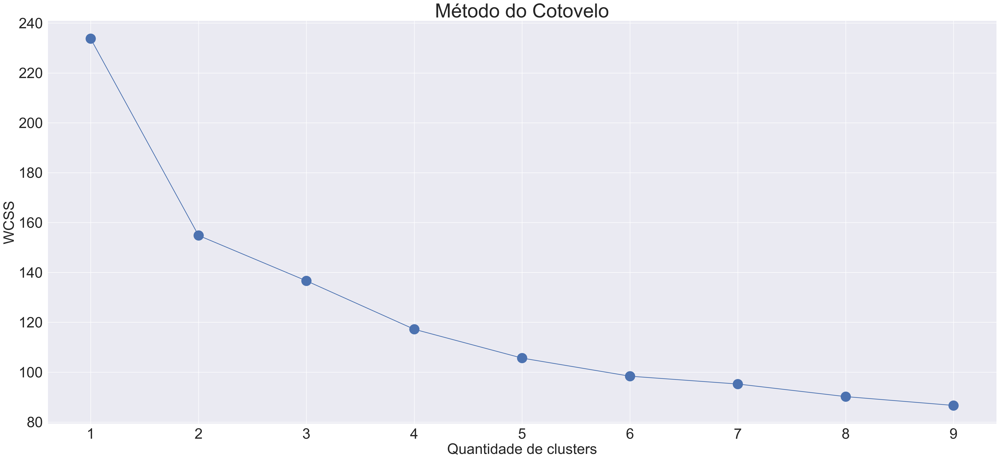

In [44]:
plt.figure(dpi=200)
plt.plot([i for i in range(1,10)], wcss, '-o', markersize=20)
plt.title('Método do Cotovelo', fontsize=40)
plt.xlabel('Quantidade de clusters', fontsize=30)
plt.xticks(fontsize=30)
plt.ylabel('WCSS', fontsize=30)
plt.yticks(fontsize=30)
print(wcss)

## 2 Clusters

In [45]:
kmeans = KMeans(n_clusters=2, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_
df_completa.head()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,1
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,0
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,0
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,0
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,0


In [46]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.191475,0.457653,0.273679,0.208920,0.847793,0.910638,0.893729,0.914092,0.907223,0.895458,0.903869,0.067851,0.751496,0.226965,0.882877,0.001099,0.519935,0.311510,0.018328,0.477821,0.416156,0.043897,0.518539,0.580835,0.367404,0.128510,0.693575,0.781243,0.270433
1,0.599771,0.448240,0.105044,0.028715,0.852326,0.669014,0.671435,0.690192,0.658131,0.513269,0.622436,0.323702,0.371126,0.486960,0.605282,0.012063,0.731157,0.272255,0.126372,0.438158,0.291203,0.355021,0.516067,0.243522,0.075828,0.129851,0.459591,0.336945,0.304752


In [47]:
df_completa['cluster'].value_counts()

cluster
0    146
1     71
Name: count, dtype: int64

In [48]:
# plt.figure(figsize=(8,6))
# sns.scatterplot(data=df_completa, x='GNI per capita Atlas method (current US$)', y='Population growth (annual %)', hue='cluster')

In [49]:
paises_id = pd.read_csv('HNP_StatsCountry.csv')
paises_id

,Country Code,Short Name,Table Name,Long Name,2-alpha code,Currency Unit,Special Notes,Region,Income Group,WB-2 code,National accounts base year,National accounts reference year,SNA price valuation,Lending category,Other groups,System of National Accounts,Alternative conversion factor,PPP survey year,Balance of Payments Manual in use,External debt Reporting status,System of trade,Government Accounting concept,IMF data dissemination standard,Latest population census,Latest household survey,Source of most recent Income and expenditure data,Vital registration complete,Latest agricultural census,Latest industrial data,Latest trade data,Unnamed: 30
0,ABW,Aruba,Aruba,Aruba,AW,Aruban florin,NaN,Latin America & Caribbean,High income,AW,2013,NaN,Value added at basic prices (VAB),NaN,NaN,Country uses the 2008 System of National Accou...,NaN,NaN,BPM6,NaN,General trade system,NaN,Enhanced General Data Dissemination System (e-...,2020 (expected),NaN,NaN,Yes,NaN,NaN,2018.0,NaN
1,AFE,Africa Eastern and Southern,Africa Eastern and Southern,Africa Eastern and Southern,ZH,NaN,"26 countries, stretching from the Red Sea in t...",NaN,NaN,ZH,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AFG,Afghanistan,Afghanistan,Islamic State of Afghanistan,AF,Afghan afghani,The reporting period for national accounts dat...,South Asia,Low income,AF,2016,NaN,Value added at basic prices (VAB),IDA,HIPC,Country uses the 1993 System of National Accou...,NaN,NaN,BPM6,Estimate,General trade system,Consolidated central government,Enhanced General Data Dissemination System (e-...,1979,"Demographic and Health Survey, 2015","Integrated household survey (IHS), 2016/17",NaN,NaN,NaN,2018.0,NaN
3,AFW,Africa Western and Central,Africa Western and Central,Africa Western and Central,ZI,NaN,"22 countries, stretching from the westernmost ...",NaN,NaN,ZI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AGO,Angola,Angola,People's Republic of Angola,AO,Angolan kwanza,The World Bank systematically assesses the app...,Sub-Saharan Africa,Lower middle income,AO,2002,NaN,Value added at basic prices (VAB),IBRD,NaN,Country uses the 1993 System of National Accou...,NaN,NaN,BPM6,Actual,General trade system,Budgetary central government,Enhanced General Data Dissemination System (e-...,2014,"Demographic and Health Survey, 2015/16","Integrated household survey (IHS), 2008/09",NaN,NaN,NaN,2018.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,XKX,Kosovo,Kosovo,Republic of Kosovo,XK,Euro,NaN,Europe & Central Asia,Upper middle income,XK,Original chained constant price data are resca...,2008.0,Value added at basic prices (VAB),IDA,NaN,Country uses the 2008 System of National Accou...,NaN,NaN,BPM6,Actual,NaN,NaN,Enhanced General Data Dissemination System (e-...,2011,"Multiple Indicator Cluster Survey, 2019/20","Expenditure survey/budget survey (ES/BS), 2015",NaN,2014,NaN,NaN,NaN
261,YEM,Yemen,"Yemen, Rep.",Republic of Yemen,YE,Yemeni rial,The World Bank systematically assesses the app...,Middle East & North Africa,Low income,RY,1990,NaN,Value added at basic prices (VAB),IDA,NaN,Country uses the 1993 System of National Accou...,NaN,NaN,BPM5 (Converted into BPM6 by IMF),Estimate,Special trade system,NaN,Enhanced General Data Dissemination System (e-...,2004,"Demographic and Health Survey, 2013","Expenditure survey/budget survey (ES/BS), 2014",NaN,NaN,2012.0,2015.0,NaN
262,ZAF,South Africa,South Africa,Republic of South Africa,ZA,South African rand,Fiscal year end: March 31; reporting period fo...,Sub-Saharan Africa,Upper middle income,ZA,2015,NaN,Value added at basic prices (VAB),IBRD,NaN,Country uses the 2008 System of National Accou...,NaN,NaN,BPM6,Actual,General trade system,Consolidated central government,Special Data Dissemination Standard (SDDS),2011,"Demographic and Health Survey, 2016","Expenditure survey/budget survey (ES/BS), 2014/1

In [50]:
paises_id.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 265 entries, 0 to 264
Data columns (total 31 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Country Code                                       265 non-null    object 
 1   Short Name                                         265 non-null    object 
 2   Table Name                                         265 non-null    object 
 3   Long Name                                          265 non-null    object 
 4   2-alpha code                                       263 non-null    object 
 5   Currency Unit                                      217 non-null    object 
 6   Special Notes                                      126 non-null    object 
 7   Region                                             217 non-null    object 
 8   Income Group                                       216 non-null    object 
 9   WB-2 code 

In [51]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo
df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,1,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,0,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,0,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,0,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,0,Andorra
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,0.160164,0.496864,0.438966,0.206664,0.979798,0.953125,0.937500,0.942267,0.939394,0.936842,0.947368,0.011009,0.829188,0.139646,0.875,7.133922e-05,0.379477,0.425588,0.017241,0.680672,0.728070,0.000000,0.550246,0.728814,0.652785,0.198611,0.750000,0.876923,0.467290,0,Virgin Islands (U.S.)
262,0.589754,0.153973,0.282585,0.034515,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000810,0.691994,0.267563,0.875,4.297161e-04,0.792349,0.365591,0.234483,0.515406,0.372807,0.091093,0.457440,0.500578,0.303742,0.147222,0.642857,0.661538,0.962808,0,West Bank and Gaza
263,0.647614,0.373906,0.037974,0.003076,0.696970,0.593750,0.593750,0.624734,0.515152,0.442105,0.438596,0.073394,0.377497,0.615766,0.250,1.136441e-02,0.779832,0.112547,0.000000,0.240896,0.370614,0.736842,0.779642,0.067012,0.018009,0.075000,0.500000,0.246154,0.491245,1,"Yemen, Rep."
264,0.739808,0.384589,0.113530,0.009910,0.959596,0.828125,0.828125,0.841234,0.909091,0.652632,0.824561,0.509174,0.306255,0.312237,0.625,7.432912e-03,0.864878,0.311767,0.396552,0.324930,0.241228,0.540486,0.459344,0.147667,0.021769,0.095833,0.392857,0.430769,0.207515,1,Zambia


In [52]:
print(len(df_completa_paises["Country_name"]))

217


In [53]:
world = geopandas.read_file(

    geopandas.datasets.get_path('naturalearth_lowres')

)
world

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,6944975.0,Europe,Serbia,SRB,51475,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,622137.0,Europe,Montenegro,MNE,5542,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1794248.0,Europe,Kosovo,-99,7926,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1394973.0,North America,Trinidad and Tobago,TTO,24269,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


In [54]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,1,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,0,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,0,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,0,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,0,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,1,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,0,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,0,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [55]:
# df_completa_paises.info()

In [56]:
cluster = df_completa_paises.groupby('cluster')

In [57]:
df_completa['cluster'].value_counts()

cluster
0    146
1     71
Name: count, dtype: int64

In [58]:
import plotly.express as px
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa", 
                    color="cluster",
                    range_color=(0, 1))
fig.show()

In [59]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

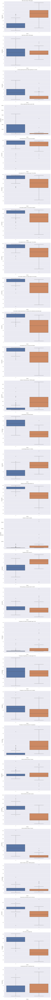

In [60]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

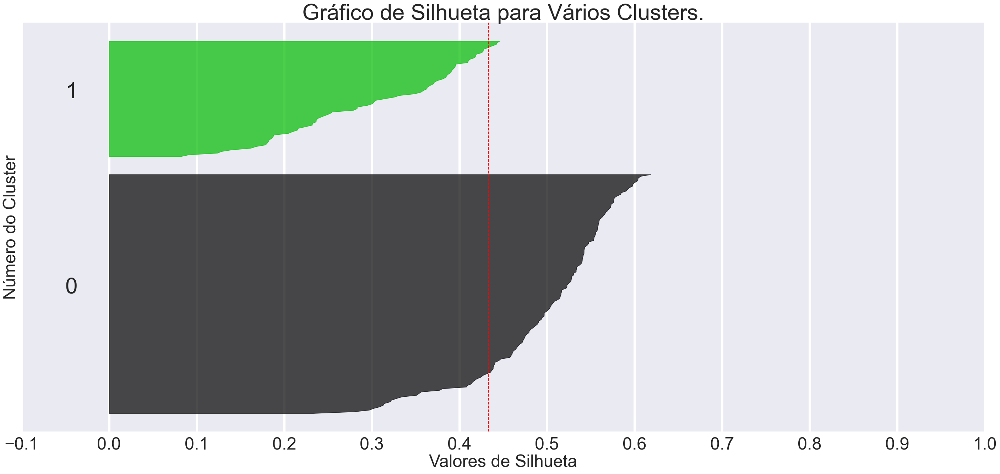

In [61]:
silhouette_avg2 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 2
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=45)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg2, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [62]:
print(silhouette_avg2)

0.43355227733985396


In [63]:
ch_score2 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score2)

Calinski-Harabasz score: 175.90401525644822


## 3 Clusters

In [64]:
kmeans = KMeans(n_clusters=3, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [65]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.098279,0.577078,0.367927,0.352176,0.694689,0.890373,0.860887,0.892216,0.879521,0.884211,0.876627,0.024504,0.852129,0.125547,0.874194,0.000390,0.485413,0.339898,0.011680,0.413527,0.469369,0.005550,0.513219,0.643929,0.508236,0.178853,0.727151,0.872457,0.238469
1,0.599771,0.448240,0.105044,0.028715,0.852326,0.669014,0.671435,0.690192,0.658131,0.513269,0.622436,0.323702,0.371126,0.486960,0.605282,0.012063,0.731157,0.272255,0.126372,0.438158,0.291203,0.355021,0.516067,0.243522,0.075828,0.129851,0.459591,0.336945,0.304752
2,0.260263,0.369505,0.204115,0.103183,0.960798,0.925595,0.917969,0.930239,0.927670,0.903759,0.923977,0.099846,0.677220,0.301820,0.889286,0.001623,0.545415,0.290558,0.023235,0.525277,0.376880,0.072200,0.522465,0.534265,0.263457,0.091353,0.668793,0.713919,0.294026


In [66]:
df_completa['cluster'].value_counts()

cluster
2    84
1    71
0    62
Name: count, dtype: int64

In [67]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [68]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,1,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,2,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,2,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,0,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,2,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,1,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,2,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,2,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [69]:
cluster = df_completa_paises.groupby('cluster')

In [70]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa", 
                    color="cluster",
                    range_color=(0, 2))
fig.show()

In [71]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

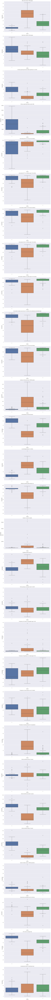

In [72]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

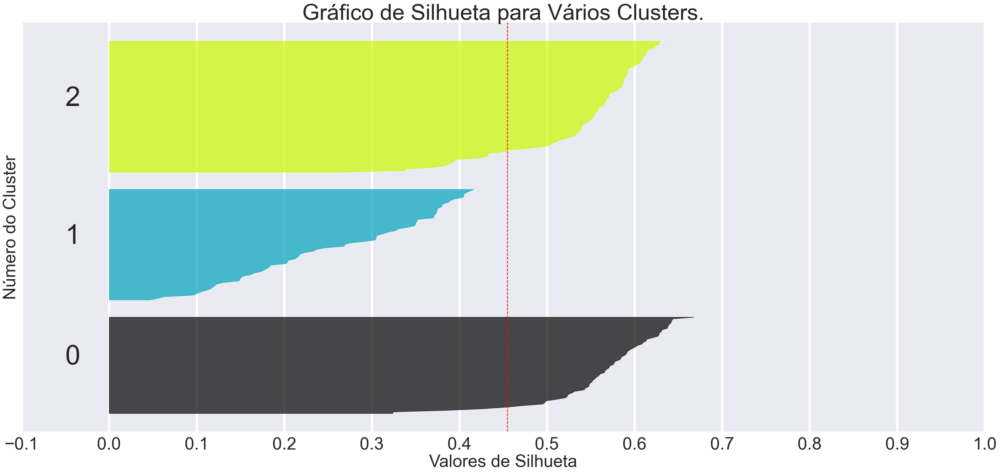

In [73]:
silhouette_avg3 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 3
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg3, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [74]:
print(silhouette_avg3)

0.45487381664329146


In [75]:
ch_score3 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score3)

Calinski-Harabasz score: 184.09064824040559


## 4 Clusters

In [76]:
kmeans = KMeans(n_clusters=4, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [77]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.087635,0.654148,0.339425,0.190490,0.937085,0.915625,0.897768,0.911338,0.887879,0.912180,0.899749,0.031018,0.804580,0.134594,0.897857,0.000218,0.447664,0.324136,0.016453,0.543337,0.548058,0.002429,0.493773,0.598930,0.512358,0.192143,0.722449,0.842198,0.265421
1,0.260263,0.369505,0.204115,0.103183,0.960798,0.925595,0.917969,0.930239,0.927670,0.903759,0.923977,0.099846,0.677220,0.301820,0.889286,0.001623,0.545415,0.290558,0.023235,0.525277,0.376880,0.072200,0.522465,0.534265,0.263457,0.091353,0.668793,0.713919,0.294026
2,0.599771,0.448240,0.105044,0.028715,0.852326,0.669014,0.671435,0.690192,0.658131,0.513269,0.622436,0.323702,0.371126,0.486960,0.605282,0.012063,0.731157,0.272255,0.126372,0.438158,0.291203,0.355021,0.516067,0.243522,0.075828,0.129851,0.459591,0.336945,0.304752
3,0.112076,0.477173,0.404874,0.561770,0.380471,0.857639,0.813079,0.867427,0.868687,0.847953,0.846654,0.016061,0.913767,0.113820,0.843519,0.000612,0.534346,0.360329,0.005492,0.245254,0.367365,0.009597,0.538426,0.702260,0.502891,0.161626,0.733245,0.911681,0.203532


In [78]:
df_completa['cluster'].value_counts()

cluster
1    84
2    71
0    35
3    27
Name: count, dtype: int64

In [79]:
cluster = df_completa_paises.groupby('cluster')

In [80]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [81]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,2,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,1,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,1,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,3,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,1,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,2,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,1,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,1,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [82]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa",
                    color="cluster",
                    range_color=(0, 3))
fig.show()

In [83]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

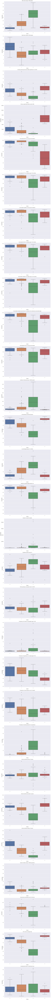

In [84]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

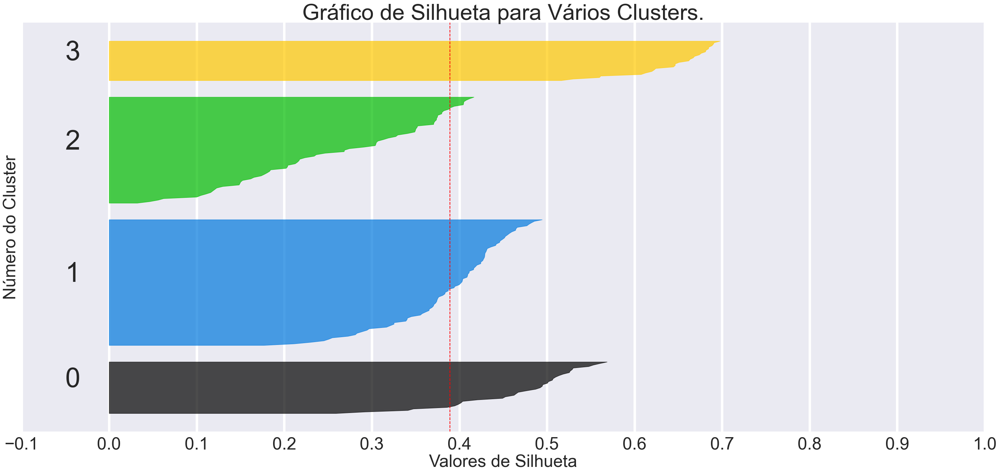

In [85]:
silhouette_avg4 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 4
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg4, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [86]:
print(silhouette_avg4)

0.38932735366981647


In [87]:
ch_score4 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score4)

Calinski-Harabasz score: 155.72726898345667


## 5 Clusters

In [88]:
kmeans = KMeans(n_clusters=5, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [89]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.087635,0.654148,0.339425,0.190490,0.937085,0.915625,0.897768,0.911338,0.887879,0.912180,0.899749,0.031018,0.804580,0.134594,0.897857,0.000218,0.447664,0.324136,0.016453,0.543337,0.548058,0.002429,0.493773,0.598930,0.512358,0.192143,0.722449,0.842198,0.265421
1,0.651220,0.504292,0.052472,0.042290,0.741259,0.416466,0.417668,0.461526,0.421911,0.210121,0.340756,0.332980,0.316418,0.515498,0.434615,0.015933,0.779543,0.160295,0.054377,0.443223,0.252868,0.488944,0.492249,0.181160,0.064605,0.083226,0.412546,0.262722,0.280755
2,0.260263,0.369505,0.204115,0.103183,0.960798,0.925595,0.917969,0.930239,0.927670,0.903759,0.923977,0.099846,0.677220,0.301820,0.889286,0.001623,0.545415,0.290558,0.023235,0.525277,0.376880,0.072200,0.522465,0.534265,0.263457,0.091353,0.668793,0.713919,0.294026
3,0.112076,0.477173,0.404874,0.561770,0.380471,0.857639,0.813079,0.867427,0.868687,0.847953,0.846654,0.016061,0.913767,0.113820,0.843519,0.000612,0.534346,0.360329,0.005492,0.245254,0.367365,0.009597,0.538426,0.702260,0.502891,0.161626,0.733245,0.911681,0.203532
4,0.570044,0.415854,0.135419,0.020872,0.916498,0.814931,0.818056,0.822310,0.794613,0.688421,0.785185,0.318342,0.402736,0.470471,0.703889,0.009826,0.703200,0.336943,0.167969,0.435232,0.313353,0.277643,0.529829,0.279554,0.082313,0.156790,0.486772,0.379829,0.318617


In [90]:
df_completa['cluster'].value_counts()

cluster
2    84
4    45
0    35
3    27
1    26
Name: count, dtype: int64

In [91]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [92]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises = df_completa_paises.sort_values(by='cluster')
df_completa_paises['cluster'] = df_completa_paises['cluster'].astype(str)
df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
73,0.073050,0.777104,0.381487,0.050662,0.969697,0.593750,0.703125,0.509267,0.484848,0.673684,0.561404,0.041284,0.753971,0.049618,0.800,3.342859e-05,0.254363,0.327686,0.027586,0.658263,0.699561,0.000000,0.397289,0.477931,0.276778,0.145833,0.452381,0.630769,0.594698,0,Bosnia and Herzegovina,Bosnia and Herzegovina
158,0.097600,0.931077,0.233422,0.148227,0.969697,1.000000,1.000000,1.000000,1.000000,0.968421,1.000000,0.036697,0.696544,0.012533,0.975,1.437990e-05,0.323236,0.311940,0.017241,0.649860,0.736842,0.000000,0.497420,0.638539,0.658996,0.273611,0.726190,0.769231,0.236887,0,Latvia,Latvia
153,0.000000,0.324557,0.291391,0.287057,0.989899,0.984375,0.984375,0.985567,0.984848,0.968421,0.982456,0.088685,0.939460,0.140515,0.975,1.914207e-04,0.475820,0.331793,0.286207,0.168067,0.390351,0.000000,0.493906,0.570562,0.652785,0.391667,0.809524,0.969231,0.139233,0,"Korea, Rep.","Korea, Rep."
147,0.027528,0.703632,0.566763,0.356600,0.979798,0.984375,1.000000,0.985567,0.954545,0.936842,0.982456,0.019878,0.974461,0.307912,0.975,4.095469e-04,0.404387,0.216837,0.000000,0.299720,0.370614,0.000000,0.524632,0.602178,0.424029,0.206944,0.726190,0.876923,0.085829,0,Japan,Japan
145,0.027528,0.662279,0.392302,0.296284,0.848485,0.953125,0.937500,0.942267,0.924242,0.884211,0.947368,0.009327,0.947849,0.136667,0.875,2.409099e-04,0.256272,0.287490,0.003448,0.366947,0.432018,0.000000,0.527744,0.595326,0.449651,0.087500,0.726190,0.907692,0.375739,0,Italy,Italy
78,0.072574,1.000000,0.248560,0.079197,0.969697,0.906250,0.906250,0.898967,0.939394,0.957895,0.894737,0.032110,0.688003,0.310323,0.950,7.843580e-05,0.321969,0.295148,0.000000,0.686275,0.785088,0.004049,0.407691,0.534719,0.518878,0.129167,0.750000,0.769231,0.157543,0,Bulgaria,Bulgaria
261,0.160164,0.496864,0.438966,0.206664,0.979798,0.953125,0.937500,0.942267,0.939394,0.936842,0.947368,0.011009,0.829188,0.139646,0.875,7.133922e-05,0.379477,0.425588,0.017241,0.680672,0.728070,0.000000,0.550246,0.728814,0.652785,0.198611,0.750000,0.876923,0.467290,0,Virgin Islands (U.S.),Virgin Islands (U.S.)
228,0.042544,0.538218,0.396898,0.257411,0.858586,0.937500,0.937500,0.956700,0.984848,0.947368,0.929825,0.015138,0.958204,0.238837,0.875,2.175660e-04,0.529919,0.297634,0.006897,0.182073,0.537281,0.000000,0.530067,0.719055,0.631412,0.101389,0.726190,0.907692,0.534045,0,Spain,Spain
97,0.075077,0.807016,0.337847,0.129688,0.989899,0.921875,0.906250,0.927833,0.909091,0.957895,0.912281,0.012691,0.790642,0.043621,0.875,3.268158e-05,0.343875,0.276898,0.000000,0.775910,0.725877,0.000000,0.463286,0.598225,0.473137,0.222222,0.726190,0.830769,0.248713,0,Croatia,Croatia
136,0.090092,0.848370,0.255644,0.139598,1.000000,1.000000,1.0000

In [93]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa",
                    color="cluster",
#                     range_color=(0, 4),
                    width=1200, height=800)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},
                 legend=dict(
                 yanchor="top",
                 y=0.99,
                 xanchor="left",
                 x=0.01
))
fig.show()

In [94]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)
df_final.to_excel('df_desnomalizada.xlsx')
df_desnormalizada_media = df_final.iloc[:, :-2].groupby('cluster').mean()
df_desnormalizada_media.to_excel('df_desnormalizada_cluster.xlsx')

In [95]:
df_cluster0 = df_final[df_final['cluster'] == "0"]
df_cluster1 = df_final[df_final['cluster'] == "1"]
df_cluster2 = df_final[df_final['cluster'] == "2"]
df_cluster3 = df_final[df_final['cluster'] == "3"]
df_cluster4 = df_final[df_final['cluster'] == "4"]

In [96]:
df_cluster0.to_excel('cluster0.xlsx')
df_cluster0

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
0,8.819,12.266,6.218837,6160.0,96.0,73.0,80.0,65.0,65.0,68.0,74.0,27.0,77.241000,5.144618,92.0,179.0,-1.166081,4.630020,0.9,44.2,35.5,2.5,90.163132,85.815811,41.597038,10.9,64.0,67.0,15.69,0,Bosnia and Herzegovina,Bosnia and Herzegovina
1,9.800,14.500,3.963067,17580.0,96.0,99.0,99.0,99.0,99.0,96.0,99.0,24.0,75.387805,4.267591,99.0,77.0,-0.695239,4.420550,0.6,43.9,37.2,2.5,99.983437,107.602463,94.864532,20.1,87.0,76.0,6.31,0,Latvia,Latvia
2,5.900,5.700,4.846221,33830.0,98.0,98.0,98.0,98.0,98.0,96.0,98.0,58.0,83.226829,7.294278,99.0,1025.0,0.347875,4.684660,8.4,26.7,21.4,2.5,99.638817,98.381302,93.998917,28.6,94.0,89.0,3.75,0,"Korea, Rep.","Korea, Rep."
3,7.000,11.200,9.041532,41970.0,97.0,98.0,99.0,98.0,96.0,93.0,98.0,13.0,84.356341,11.253117,99.0,2193.0,-0.140465,3.155340,0.1,31.4,20.5,2.5,102.652283,102.670067,62.118500,15.3,87.0,83.0,2.35,0,Japan,Japan
4,7.000,10.600,6.383605,34910.0,84.0,96.0,95.0,95.0,94.0,88.0,96.0,6.1,83.497561,7.203278,95.0,1290.0,-1.153028,4.095270,0.2,33.8,23.3,2.5,102.957497,101.740547,65.689369,6.7,87.0,85.0,9.95,0,Italy,Italy
5,8.800,15.500,4.193689,9500.0,96.0,93.0,93.0,92.0,95.0,95.0,93.0,21.0,75.112195,11.310137,98.0,420.0,-0.703906,4.197150,0.1,45.2,39.4,2.7,91.183311,93.519180,75.337097,9.7,89.0,76.0,4.23,0,Bulgaria,Bulgaria
6,12.300,8.200,7.094534,24420.0,97.0,96.0,95.0,95.0,95.0,93.0,96.0,7.2,79.668293,7.273723,95.0,382.0,-0.310760,5.932460,0.6,45.0,36.8,2.5,105.164360,119.848534,93.998917,14.7,89.0,83.0,12.35,0,Virgin Islands (U.S.),Virgin Islands (U.S.)
7,7.600,8.800,6.453632,30360.0,85.0,95.0,95.0,96.0,98.0,94.0,95.0,9.9,83.831707,9.619541,95.0,1165.0,0.717716,4.230220,0.3,27.2,28.1,2.5,103.185318,118.524719,91.020264,7.7,87.0,85.0,14.10,0,Spain,Spain
8,8.900,12.700,5.553976,15410.0,98.0,94.0,93.0,94.0,93.0,95.0,94.0,8.3,78.424390,5.002799,95.0,175.0,-0.554147,3.954370,0.1,48.4,36.7,2.5,96.635803,102.133850,68.962372,16.4,87.0,80.0,6.62,0,Croatia,Croatia
9,9.500,13.300,4.301617,16570.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,6.2,76.319512,8.326790,99.0,382.0,-0.045256,4.224880,0.4,48.3,32.2,2.5,96.614731,102.559807,52.360260,16.6,87.0,79.0,3.42,0,Hungary,Hungary


In [97]:
df_cluster1.to_excel('cluster1.xlsx')
df_cluster1

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
35,31.874,8.582,0.643422,5520.0,85.0,53.0,53.0,53.0,53.0,9.0,55.0,286.0,61.644000,18.818874,65.0,3952.0,3.335037,2.122014,6.9,38.1,8.7,27.0,51.199013,41.014801,5.373222,7.9,34.0,44.0,8.277,1,Equatorial Guinea,Equatorial Guinea
36,33.123,6.439,0.730885,830.0,69.0,68.0,68.0,68.0,58.0,41.0,71.0,140.0,65.838000,14.662200,93.0,185220.0,2.656010,4.480869,0.9,27.4,5.2,20.7,92.699898,37.450481,6.936960,5.4,70.0,36.0,3.219,1,Ethiopia,Ethiopia
37,44.564,11.041,0.737226,570.0,37.0,42.0,42.0,42.0,46.0,9.0,47.0,258.0,57.078000,19.868751,67.0,80448.0,3.633165,0.270662,0.1,36.1,17.9,51.9,83.257393,20.983530,5.869890,7.9,41.0,26.0,18.828,1,Somalia,Somalia
38,42.376,9.205,1.312284,820.0,83.0,77.0,77.0,77.0,70.0,4.0,72.0,52.0,59.664000,16.344429,85.0,86719.0,3.126670,3.555050,0.9,34.6,8.6,6.6,90.719032,35.099899,4.734406,4.1,64.0,40.0,1.619,1,Mali,Mali
39,24.304,7.953,0.407457,1410.0,73.0,51.0,51.0,51.0,65.0,41.0,51.0,170.0,64.255000,15.541491,81.0,16829.0,1.335139,1.759413,1.9,42.9,7.9,43.6,101.853394,42.022129,9.995644,9.6,69.0,53.0,13.781,1,Haiti,Haiti
40,35.436,9.712,0.916117,940.0,73.0,47.0,47.0,47.0,47.0,20.0,48.0,176.0,59.720000,15.541491,80.0,46437.0,2.537647,1.858130,1.5,40.9,7.1,12.5,98.141830,37.991924,6.843963,7.0,72.0,39.0,5.020,1,Guinea,Guinea
41,32.093,8.206,0.534187,780.0,84.0,78.0,78.0,78.0,79.0,9.0,60.0,361.0,60.882000,19.831929,83.0,4979.0,2.336290,3.022214,3.3,38.0,9.3,35.3,96.609337,37.450481,6.843963,7.0,34.0,36.0,3.175,1,Guinea-Bissau,Guinea-Bissau
42,12.849,8.458,5.016178,26960.0,83.0,66.0,68.0,67.0,68.0,54.0,60.0,11.0,75.326000,13.234736,85.0,3.0,3.767873,2.505090,1.8,38.6,17.9,11.3,119.490044,91.092781,11.760300,5.7,87.0,69.0,5.755,1,Turks and Caicos Islands,Turks and Caicos Islands
43,26.370,6.468,1.356231,2430.0,45.0,35.0,35.0,35.0,37.0,20.0,42.0,432.0,65.474000,19.356366,70.0,11306.0,2.260188,1.784450,0.9,27.8,39.9,23.1,98.709282,52.607288,19.619732,3.0,74.0,30.0,2.432,1,Papua New Guinea,Papua New Guinea
44,37.849,12.989,0.469804,2110.0,75.0,66.0,66.0,66.0,58.0,9.0,66.0,219.0,52.910000,18.353916,60.0,873031.0,2.448201,2.372458,1.4,36.1,3.9,12.4,83.257393,33.934151,6.843963,3.5,26.0,43.0,5.206,1,Nigeria,Nigeria


In [98]:
df_cluster2.to_excel('cluster2.xlsx')
df_cluster2

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
61,18.350,5.280,0.518663,2210.0,99.0,98.0,98.0,98.0,97.0,93.0,98.0,221.00,72.806000,23.143533,98.0,91820.0,1.113172,1.681388,0.1,28.8,35.2,11.8,98.842407,67.220917,22.805214,3.7,80.0,50.0,4.382,2,Bangladesh,Bangladesh
62,17.663,8.692,0.737226,1370.0,91.0,90.0,90.0,90.0,84.0,80.0,90.0,322.00,66.610000,12.487266,90.0,41910.0,0.707999,2.139870,0.8,37.8,45.1,2.9,112.228210,91.092781,36.268372,2.9,79.0,60.0,0.410,2,Myanmar,Myanmar
63,15.200,6.000,4.257456,37170.0,93.0,96.0,95.0,95.0,95.0,91.0,96.0,9.30,80.419707,11.373494,95.0,959.0,0.025811,3.979540,0.2,43.2,17.9,5.9,102.447647,101.415771,53.306820,6.4,87.0,77.0,10.880,2,New Caledonia,New Caledonia
64,29.124,6.480,10.907102,15550.0,99.0,96.0,96.0,96.0,95.0,95.0,96.0,161.00,63.484000,14.920634,95.0,10.0,1.729341,6.224422,8.4,41.8,49.2,19.0,100.000000,86.360367,16.353960,14.5,87.0,60.0,15.690,2,Nauru,Nauru
65,10.885,8.910,2.777067,17680.0,94.0,90.0,90.0,90.0,92.0,77.0,91.0,0.00,77.257000,8.900632,95.0,39.0,0.175756,4.111230,0.9,41.8,8.5,2.5,98.842407,106.328201,54.964180,0.6,87.0,79.0,8.410,2,Barbados,Barbados
66,21.305,4.626,5.269987,1880.0,99.0,98.0,98.0,98.0,99.0,99.0,99.0,43.00,74.054000,10.164118,90.0,2121.0,1.385485,4.599920,0.3,35.8,14.2,17.5,108.948524,88.887833,17.767614,4.4,79.0,73.0,5.202,2,Nicaragua,Nicaragua
67,28.267,4.843,1.897775,1070.0,98.0,97.0,97.0,97.0,98.0,97.0,97.0,83.00,70.867000,8.792606,95.0,8770.0,2.262425,5.568055,0.2,46.8,24.4,9.8,106.272949,75.856392,15.000000,4.3,74.0,70.0,7.044,2,Tajikistan,Tajikistan
68,24.300,4.600,2.258706,1880.0,99.0,96.0,96.0,96.0,98.0,99.0,98.0,67.00,71.344000,5.807447,92.0,12082.0,1.876470,6.295347,0.2,45.7,17.8,2.5,100.332474,96.683311,12.770705,8.0,73.0,75.0,5.861,2,Uzbekistan,Uzbekistan
69,23.292,5.499,2.470464,3840.0,99.0,98.0,98.0,98.0,98.0,98.0,98.0,428.00,71.822000,4.987122,91.0,1206.0,2.139997,3.652370,0.1,42.8,29.6,5.1,96.095245,90.467346,63.418369,17.9,31.0,67.0,5.443,2,Mongolia,Mongolia
70,9.600,9.800,4.257456,5890.0,93.0,92.0,92.0,92.0,75.0,94.0,92.0,12.00,76.602439,8.272586,95.0,144.0,0.022972,3.979540,0.8,45.1,23.0,2.9,92.511772,77.282310,39.739899,9.4,79.0,74.0,17.390,2,North Macedonia,North Macedonia


In [99]:
df_cluster3.to_excel('cluster3.xlsx')
df_cluster3

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
145,9.13800,10.057000,6.812496,82430.0,25.0,84.0,84.0,85.0,88.0,82.0,84.0,2.4,81.404878,6.469694,90.0,2726.0,-2.304139,4.772930,1.1,29.7,23.4,2.5,119.490044,114.804169,79.304482,16.6,87.0,86.0,5.540,3,American Samoa,American Samoa
146,12.10000,6.700000,7.549840,54970.0,25.0,95.0,95.0,95.0,94.0,94.0,95.0,6.8,82.900000,6.533125,95.0,1171.0,1.477491,5.134290,0.1,29.3,14.0,2.5,100.199699,144.056564,109.759560,12.5,87.0,87.0,5.160,3,Australia,Australia
147,9.83413,8.547311,6.812496,72820.0,37.0,85.0,82.0,85.0,91.0,76.0,85.0,0.0,81.390000,6.281638,91.0,226.0,1.277830,6.624621,0.2,31.3,16.1,2.5,117.423347,144.056564,75.114853,10.9,92.0,87.0,6.777,3,Channel Islands,Channel Islands
148,13.08800,3.391000,3.624185,84490.0,51.0,84.0,78.0,85.0,84.0,75.0,85.0,19.0,82.996000,11.373494,93.0,13529.0,0.706823,2.825655,0.2,29.3,22.8,5.9,96.609337,101.415771,42.273781,6.1,88.0,82.0,12.135,3,French Polynesia,French Polynesia
149,10.50000,9.300000,8.472565,63140.0,51.0,97.0,97.0,97.0,96.0,90.0,97.0,5.2,81.451220,4.835727,95.0,228.0,0.358131,6.909700,0.1,35.9,18.1,2.5,100.551003,129.311127,81.694588,10.7,87.0,82.0,5.020,3,Denmark,Denmark
150,13.20000,8.000000,7.094534,66090.0,51.0,71.0,70.0,70.0,73.0,59.0,76.0,15.0,82.946341,7.723325,90.0,6133.0,1.414732,4.987280,0.5,21.9,16.1,5.1,104.938019,104.076897,52.360260,9.7,87.0,85.0,6.777,3,Faroe Islands,Faroe Islands
151,8.20000,8.400000,4.602066,117280.0,51.0,84.0,79.0,85.0,84.0,80.0,84.0,3.6,81.033000,9.027737,90.0,4014.0,-0.010952,1.926798,0.4,37.6,27.1,4.5,94.086296,81.548271,56.666302,14.0,87.0,78.0,4.230,3,Bermuda,Bermuda
152,10.29500,3.983000,4.555334,72820.0,0.0,72.0,70.0,70.0,73.0,72.0,76.0,63.0,84.978000,9.364365,93.0,17603.0,1.926361,3.058630,0.5,29.3,19.8,6.4,88.879784,87.322151,82.401443,12.5,87.0,82.0,1.750,3,"Macao SAR, China","Macao SAR, China"
153,10.70000,9.000000,7.922252,43240.0,70.0,93.0,93.0,93.0,91.0,87.0,93.0,8.1,81.404878,6.860311,95.0,3136.0,0.564131,5.248710,0.1,26.4,16.1,2.5,99.131020,117.060471,65.964561,7.9,89.0,87.0,3.740,3,United Kingdom,United Kingdom
154,11.40000,8.700000,8.595796,66130.0,0.0,94.0,91.0,91.0,90.0,95.0,93.0,2.9,78.787805,8.238230,95.0,24454.0,0.455381,4.987280,0.4,31.6,23.4,2.5,100.981300,100.063431,87.888710,16.1,87.0,85.0,3.670,3,United States,United States


In [100]:
df_cluster4.to_excel('cluster4.xlsx')
df_cluster4

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
172,37.667,5.823,0.574142,810.0,88.0,93.0,93.0,93.0,87.0,66.0,92.0,200.0,62.991,16.274886,85.0,71323.0,3.395091,2.308281,5.5,32.5,8.9,32.5,94.781754,33.934151,6.843963,4.6,77.0,48.0,3.554,4,Uganda,Uganda
173,18.409,7.060,6.141758,6020.0,84.0,77.0,77.0,77.0,64.0,32.0,76.0,29.0,72.242,16.372945,93.0,201.0,1.103179,5.619970,1.3,42.9,20.8,9.0,104.893181,87.379333,15.281201,25.4,77.0,72.0,8.029,4,Suriname,Suriname
174,25.511,6.888,3.435193,2420.0,95.0,90.0,90.0,90.0,85.0,80.0,90.0,498.0,68.268,18.239341,83.0,1757.0,1.462727,4.176562,0.2,35.3,39.8,23.8,111.470078,85.316658,19.619732,3.7,64.0,50.0,4.452,4,Timor-Leste,Timor-Leste
175,37.113,6.012,1.568853,1040.0,91.0,89.0,89.0,89.0,88.0,72.0,89.0,237.0,66.989,9.776668,91.0,108822.0,3.021746,3.596836,4.8,33.2,9.2,22.3,94.781754,30.073891,3.024230,4.3,57.0,42.0,2.214,4,Tanzania,Tanzania
176,32.756,8.465,0.863342,880.0,98.0,84.0,84.0,84.0,75.0,53.0,78.0,37.0,60.901,14.360087,83.0,17619.0,2.411630,4.201668,2.0,36.0,7.1,18.8,121.971062,42.793709,13.323420,8.8,84.0,41.0,3.707,4,Togo,Togo
177,30.400,5.663,1.904403,3590.0,97.0,90.0,90.0,90.0,80.0,66.0,90.0,41.0,69.877,13.046362,78.0,226.0,2.362076,1.774070,0.6,39.5,18.2,10.8,115.607674,67.142776,13.765874,18.0,74.0,46.0,1.757,4,Vanuatu,Vanuatu
178,34.823,6.586,1.002137,940.0,92.0,93.0,93.0,93.0,90.0,74.0,93.0,67.0,65.876,16.244116,80.0,85393.0,2.893590,3.002736,0.2,40.8,14.0,11.3,98.235413,37.991924,6.843963,3.8,69.0,45.0,17.586,4,Sudan,Sudan
179,22.786,6.505,0.960378,2520.0,85.0,80.0,80.0,80.0,83.0,56.0,80.0,155.0,68.138,16.802776,90.0,7516.0,1.495405,2.122014,0.3,28.5,32.5,5.4,102.567726,64.990318,13.765874,5.4,61.0,51.0,3.273,4,Lao PDR,Lao PDR
180,30.762,4.989,3.360970,2390.0,77.0,94.0,94.0,94.0,81.0,54.0,93.0,66.0,70.382,13.234736,85.0,412.0,2.360101,4.480869,1.7,29.8,36.8,19.9,104.318100,64.990318,19.619732,14.7,80.0,46.0,0.744,4,Solomon Islands,Solomon Islands
181,28.078,4.301,2.101353,5470.0,98.0,84.0,84.0,84.0,82.0,86.0,85.0,28.0,71.576,10.852940,75.0,30399.0,2.368388,3.355792,0.1,48.1,18.8,16.9,104.893181,81.170517,20.219126,3.6,57.0,58.0,15.110,4,Iraq,Iraq


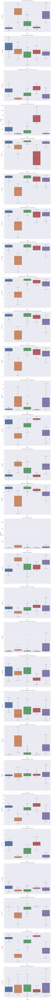

In [101]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

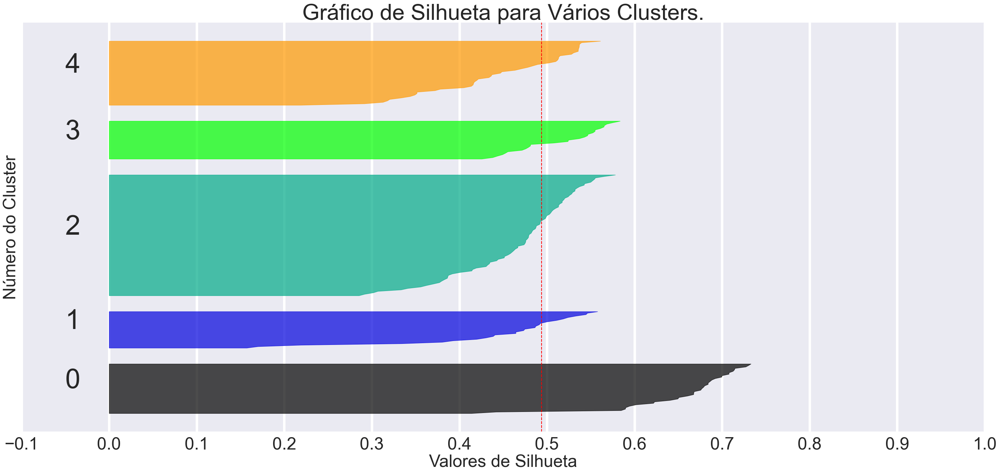

In [102]:
silhouette_avg5 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 5
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg5, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [103]:
print(silhouette_avg5)

0.49399649343893337


In [104]:
ch_score5 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score5)

Calinski-Harabasz score: 245.5590764029623


## 6 Clusters

In [105]:
kmeans = KMeans(n_clusters=6, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [106]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.087635,0.654148,0.339425,0.190490,0.937085,0.915625,0.897768,0.911338,0.887879,0.912180,0.899749,0.031018,0.804580,0.134594,0.897857,0.000218,0.447664,0.324136,0.016453,0.543337,0.548058,0.002429,0.493773,0.598930,0.512358,0.192143,0.722449,0.842198,0.265421
1,0.260263,0.369505,0.204115,0.103183,0.960798,0.925595,0.917969,0.930239,0.927670,0.903759,0.923977,0.099846,0.677220,0.301820,0.889286,0.001623,0.545415,0.290558,0.023235,0.525277,0.376880,0.072200,0.522465,0.534265,0.263457,0.091353,0.668793,0.713919,0.294026
2,0.592369,0.399376,0.097727,0.017161,0.914824,0.814611,0.814611,0.828751,0.792793,0.682788,0.786629,0.246996,0.415167,0.487159,0.697297,0.011682,0.738833,0.271458,0.069245,0.411159,0.291489,0.269395,0.511794,0.240549,0.067538,0.104167,0.479730,0.359667,0.234158
3,0.651220,0.504292,0.052472,0.042290,0.741259,0.416466,0.417668,0.461526,0.421911,0.210121,0.340756,0.332980,0.316418,0.515498,0.434615,0.015933,0.779543,0.160295,0.054377,0.443223,0.252868,0.488944,0.492249,0.181160,0.064605,0.083226,0.412546,0.262722,0.280755
4,0.112076,0.477173,0.404874,0.561770,0.380471,0.857639,0.813079,0.867427,0.868687,0.847953,0.846654,0.016061,0.913767,0.113820,0.843519,0.000612,0.534346,0.360329,0.005492,0.245254,0.367365,0.009597,0.538426,0.702260,0.502891,0.161626,0.733245,0.911681,0.203532
5,0.466791,0.492065,0.309744,0.038039,0.924242,0.816406,0.833984,0.792521,0.803030,0.714474,0.778509,0.648318,0.345242,0.393289,0.734375,0.001245,0.538400,0.639812,0.624569,0.546569,0.414474,0.315789,0.613242,0.459951,0.150648,0.400174,0.519345,0.473077,0.709236


In [107]:
df_completa['cluster'].value_counts()

cluster
1    84
2    37
0    35
4    27
3    26
5     8
Name: count, dtype: int64

In [108]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [109]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,3,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,1,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,1,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,4,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,1,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,3,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,1,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,1,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [110]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa",
                    color="cluster",
                    range_color=(0, 5))
fig.show()

In [111]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

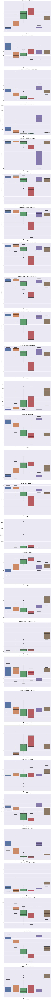

In [112]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

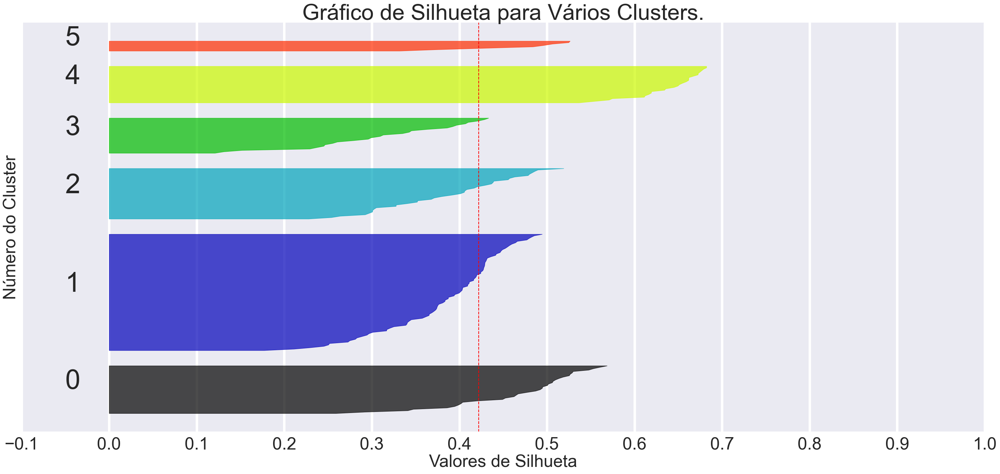

In [113]:
silhouette_avg6 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 6
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg6, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [114]:
print(silhouette_avg6)

0.42220445694124176


In [115]:
ch_score6 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score6)

Calinski-Harabasz score: 233.85188851068108


## 7 Clusters

In [116]:
kmeans = KMeans(n_clusters=7, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [117]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.087635,0.654148,0.339425,0.190490,0.937085,0.915625,0.897768,0.911338,0.887879,0.912180,0.899749,0.031018,0.804580,0.134594,0.897857,0.000218,0.447664,0.324136,0.016453,0.543337,0.548058,0.002429,0.493773,0.598930,0.512358,0.192143,0.722449,0.842198,0.265421
1,0.651220,0.504292,0.052472,0.042290,0.741259,0.416466,0.417668,0.461526,0.421911,0.210121,0.340756,0.332980,0.316418,0.515498,0.434615,0.015933,0.779543,0.160295,0.054377,0.443223,0.252868,0.488944,0.492249,0.181160,0.064605,0.083226,0.412546,0.262722,0.280755
2,0.216212,0.247049,0.224367,0.175261,0.961953,0.957812,0.954688,0.961511,0.959596,0.934386,0.957310,0.060097,0.771101,0.301319,0.907500,0.001438,0.581809,0.272270,0.007126,0.435294,0.307602,0.048516,0.527895,0.577804,0.306830,0.071667,0.701984,0.773846,0.225421
3,0.112076,0.477173,0.404874,0.561770,0.380471,0.857639,0.813079,0.867427,0.868687,0.847953,0.846654,0.016061,0.913767,0.113820,0.843519,0.000612,0.534346,0.360329,0.005492,0.245254,0.367365,0.009597,0.538426,0.702260,0.502891,0.161626,0.733245,0.911681,0.203532
4,0.592369,0.399376,0.097727,0.017161,0.914824,0.814611,0.814611,0.828751,0.792793,0.682788,0.786629,0.246996,0.415167,0.487159,0.697297,0.011682,0.738833,0.271458,0.069245,0.411159,0.291489,0.269395,0.511794,0.240549,0.067538,0.104167,0.479730,0.359667,0.234158
5,0.284735,0.437537,0.192864,0.063140,0.960157,0.907697,0.897569,0.912866,0.909933,0.886745,0.905458,0.121929,0.625063,0.302099,0.879167,0.001725,0.525196,0.300718,0.032184,0.575267,0.415367,0.085358,0.519448,0.510077,0.239361,0.102289,0.650353,0.680627,0.332140
6,0.466791,0.492065,0.309744,0.038039,0.924242,0.816406,0.833984,0.792521,0.803030,0.714474,0.778509,0.648318,0.345242,0.393289,0.734375,0.001245,0.538400,0.639812,0.624569,0.546569,0.414474,0.315789,0.613242,0.459951,0.150648,0.400174,0.519345,0.473077,0.709236


In [118]:
df_completa['cluster'].value_counts()

cluster
5    54
4    37
0    35
2    30
3    27
1    26
6     8
Name: count, dtype: int64

In [119]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [120]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,1,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,5,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,5,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,3,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,2,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,1,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,2,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,5,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [121]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa",
                    color="cluster",
                    range_color=(0, 6))
fig.show()

In [122]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

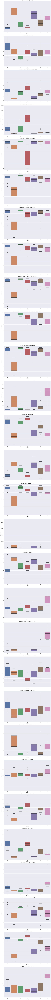

In [123]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

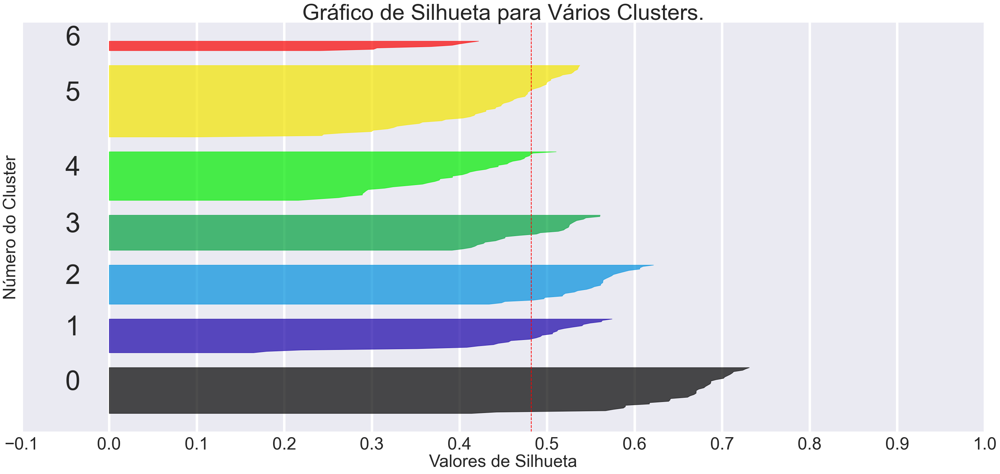

In [124]:
silhouette_avg7 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 7
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg7, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [125]:
print(silhouette_avg7)

0.482054447796193


In [126]:
ch_score7 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score7)

Calinski-Harabasz score: 329.95997026818054


## 8 Clusters

In [127]:
kmeans = KMeans(n_clusters=8, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [128]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.087635,0.654148,0.339425,0.190490,0.937085,0.915625,0.897768,0.911338,0.887879,0.912180,0.899749,0.031018,0.804580,0.134594,0.897857,0.000218,0.447664,0.324136,0.016453,0.543337,0.548058,0.002429,0.493773,0.598930,0.512358,0.192143,0.722449,0.842198,0.265421
1,0.281741,0.433867,0.177635,0.063297,0.959405,0.908019,0.897700,0.913128,0.909091,0.885998,0.905991,0.115690,0.630210,0.302798,0.881604,0.001758,0.524786,0.295942,0.024789,0.570424,0.409798,0.083149,0.520971,0.511338,0.242558,0.099135,0.647574,0.685922,0.323643
2,0.216212,0.247049,0.224367,0.175261,0.961953,0.957812,0.954688,0.961511,0.959596,0.934386,0.957310,0.060097,0.771101,0.301319,0.907500,0.001438,0.581809,0.272270,0.007126,0.435294,0.307602,0.048516,0.527895,0.577804,0.306830,0.071667,0.701984,0.773846,0.225421
3,0.772806,0.623804,0.028006,0.013280,0.630752,0.239583,0.239583,0.297579,0.239057,0.111111,0.175439,0.446993,0.162791,0.586615,0.216667,0.025764,0.808986,0.111451,0.068582,0.450669,0.226121,0.536212,0.357573,0.122711,0.049971,0.083951,0.330688,0.129915,0.285748
4,0.592369,0.399376,0.097727,0.017161,0.914824,0.814611,0.814611,0.828751,0.792793,0.682788,0.786629,0.246996,0.415167,0.487159,0.697297,0.011682,0.738833,0.271458,0.069245,0.411159,0.291489,0.269395,0.511794,0.240549,0.067538,0.104167,0.479730,0.359667,0.234158
5,0.112076,0.477173,0.404874,0.561770,0.380471,0.857639,0.813079,0.867427,0.868687,0.847953,0.846654,0.016061,0.913767,0.113820,0.843519,0.000612,0.534346,0.360329,0.005492,0.245254,0.367365,0.009597,0.538426,0.702260,0.502891,0.161626,0.733245,0.911681,0.203532
6,0.464195,0.507616,0.386439,0.039907,0.932660,0.824653,0.840278,0.804348,0.819865,0.738012,0.789474,0.626572,0.346023,0.379038,0.736111,0.001107,0.539349,0.630259,0.602299,0.578276,0.447368,0.303194,0.593855,0.458095,0.141679,0.385648,0.550265,0.464957,0.717371
7,0.586852,0.441020,0.065424,0.057648,0.799762,0.510110,0.511949,0.548322,0.518717,0.262539,0.428277,0.272621,0.397750,0.477848,0.550000,0.010728,0.763956,0.186154,0.046856,0.439282,0.267028,0.463920,0.563548,0.212103,0.072353,0.082843,0.455882,0.333032,0.278112


In [129]:
df_completa['cluster'].value_counts()

cluster
1    53
4    37
0    35
2    30
5    27
7    17
3     9
6     9
Name: count, dtype: int64

In [130]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [131]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,7,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,1,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,1,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,5,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,2,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,3,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,2,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,1,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [132]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa",
                    color="cluster",
                    range_color=(0, 7))
fig.show()

In [133]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

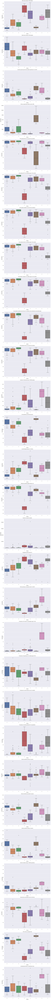

In [134]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

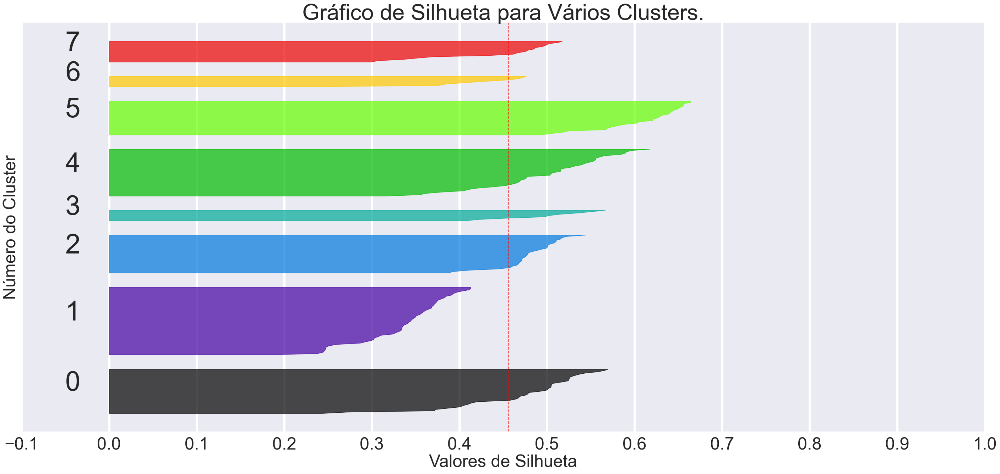

In [135]:
silhouette_avg8 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 8
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg8, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [136]:
print(silhouette_avg8)

0.45571795200700005


In [137]:
ch_score8 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score8)

Calinski-Harabasz score: 388.61719238435677


## 9 Clusters

In [138]:
kmeans = KMeans(n_clusters=9, random_state=5)
kmeans.fit(df_completa)
kmeans.labels_
df_completa['cluster'] = kmeans.labels_

In [139]:
df_completa.groupby('cluster').mean()

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force)
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.087635,0.654148,0.339425,0.190490,0.937085,0.915625,0.897768,0.911338,0.887879,0.912180,0.899749,0.031018,0.804580,0.134594,0.897857,0.000218,0.447664,0.324136,0.016453,0.543337,0.548058,0.002429,0.493773,0.598930,0.512358,0.192143,0.722449,0.842198,0.265421
1,0.709485,0.429236,0.070423,0.007496,0.932483,0.871711,0.871711,0.881495,0.828549,0.686981,0.849492,0.247787,0.325210,0.436814,0.718421,0.008961,0.811134,0.306742,0.124319,0.405278,0.159164,0.350948,0.510107,0.154261,0.036929,0.094225,0.461779,0.293117,0.184354
2,0.464195,0.507616,0.386439,0.039907,0.932660,0.824653,0.840278,0.804348,0.819865,0.738012,0.789474,0.626572,0.346023,0.379038,0.736111,0.001107,0.539349,0.630259,0.602299,0.578276,0.447368,0.303194,0.593855,0.458095,0.141679,0.385648,0.550265,0.464957,0.717371
3,0.281741,0.433867,0.177635,0.063297,0.959405,0.908019,0.897700,0.913128,0.909091,0.885998,0.905991,0.115690,0.630210,0.302798,0.881604,0.001758,0.524786,0.295942,0.024789,0.570424,0.409798,0.083149,0.520971,0.511338,0.242558,0.099135,0.647574,0.685922,0.323643
4,0.112076,0.477173,0.404874,0.561770,0.380471,0.857639,0.813079,0.867427,0.868687,0.847953,0.846654,0.016061,0.913767,0.113820,0.843519,0.000612,0.534346,0.360329,0.005492,0.245254,0.367365,0.009597,0.538426,0.702260,0.502891,0.161626,0.733245,0.911681,0.203532
5,0.586852,0.441020,0.065424,0.057648,0.799762,0.510110,0.511949,0.548322,0.518717,0.262539,0.428277,0.272621,0.397750,0.477848,0.550000,0.010728,0.763956,0.186154,0.046856,0.439282,0.267028,0.463920,0.563548,0.212103,0.072353,0.082843,0.455882,0.333032,0.278112
6,0.772806,0.623804,0.028006,0.013280,0.630752,0.239583,0.239583,0.297579,0.239057,0.111111,0.175439,0.446993,0.162791,0.586615,0.216667,0.025764,0.808986,0.111451,0.068582,0.450669,0.226121,0.536212,0.357573,0.122711,0.049971,0.083951,0.330688,0.129915,0.285748
7,0.468747,0.367856,0.126547,0.027362,0.896184,0.754340,0.754340,0.773076,0.755051,0.678363,0.720273,0.246160,0.510122,0.540301,0.675000,0.014554,0.662515,0.234213,0.011111,0.417367,0.431165,0.183311,0.513575,0.331631,0.099847,0.114660,0.498677,0.429915,0.286729
8,0.216212,0.247049,0.224367,0.175261,0.961953,0.957812,0.954688,0.961511,0.959596,0.934386,0.957310,0.060097,0.771101,0.301319,0.907500,0.001438,0.581809,0.272270,0.007126,0.435294,0.307602,0.048516,0.527895,0.577804,0.306830,0.071667,0.701984,0.773846,0.225421


In [140]:
df_completa['cluster'].value_counts()

cluster
3    53
0    35
8    30
4    27
1    19
7    18
5    17
6     9
2     9
Name: count, dtype: int64

In [141]:
df_completa_paises = df_completa.copy()
df_completa_paises['Country_name'] = paises_sem_grupo

In [142]:
pd.set_option('display.max_rows', None)

mapeamento_codigo_pais1 = dict(zip(world['iso_a3'], paises_id['Country Code']))
mapeamento_codigo_pais2 = dict(zip(world['iso_a3'], paises_id['Country Code']))

# Adicionar a coluna de código do país ao DataFrame com base no nome do país
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].map(mapeamento_codigo_pais1)
df_completa_paises['iso_alfa'] = df_completa_paises['Country_name'].fillna(mapeamento_codigo_pais2)
df_completa_paises.loc[df_completa_paises['iso_alfa'] == 'Turkiye', 'iso_alfa'] = 'Turkey'

df_completa_paises

,Birth rate crude (per 1000 people),Death rate crude (per 1000 people),Domestic general government health expenditure (% of GDP),GNI per capita Atlas method (current US$),Immunization BCG (% of one-year-old children),Immunization DPT (% of children ages 12-23 months),Immunization HepB3 (% of one-year-old children),Immunization Hib3 (% of children ages 12-23 months),Immunization measles (% of children ages 12-23 months),Immunization measles second dose (% of children by the nationally recommended age),Immunization Pol3 (% of one-year-old children),Incidence of tuberculosis (per 100000 people),Life expectancy at birth total (years),Low-birthweight babies (% of births),Newborns protected against tetanus (%),Number of under-five deaths,Population growth (annual %),Public spending on education total (% of GDP),Prevalence of HIV total (% of population ages 15-49),Prevalence of hypertension (% of adults ages 30-79),Prevalence of current tobacco use (% of adults),Prevalence of undernourishment (% of population),School enrollment primary (% gross),School enrollment secondary (% gross),School enrollment tertiary (% gross),Suicide mortality rate (per 100000 population),Tuberculosis case detection rate (% all forms),UHC service coverage index,Unemployment total (% of total labor force),cluster,Country_name,iso_alfa
49,0.764934,0.399752,0.005920,0.002478,0.868687,0.578125,0.578125,0.610301,0.469697,0.389474,0.578947,0.288991,0.330178,0.615766,0.200,1.506658e-02,0.850384,0.119327,0.000000,0.546218,0.442982,0.493927,0.599628,0.095470,0.020419,0.051389,0.571429,0.246154,0.419035,5,Afghanistan,Afghanistan
50,0.111189,0.516162,0.161498,0.042717,1.000000,1.000000,1.000000,1.000000,0.939394,0.968421,1.000000,0.024465,0.817217,0.084382,0.900,5.303754e-05,0.362619,0.274032,0.000000,0.591036,0.425439,0.032389,0.541537,0.576932,0.423724,0.054167,0.726190,0.584615,0.433721,3,Albania,Albania
51,0.435396,0.234406,0.240212,0.032636,1.000000,0.828125,0.828125,0.841234,0.712121,0.757895,0.807018,0.093272,0.730203,0.134835,0.950,4.380452e-03,0.694002,0.433439,0.000000,0.434174,0.381579,0.000000,0.576866,0.519795,0.367107,0.029167,0.654762,0.738462,0.396529,3,Algeria,Algeria
52,0.081033,0.624854,0.420454,0.702264,0.252525,0.765625,0.765625,0.797934,0.833333,0.821053,0.736842,0.003670,0.883001,0.105648,0.750,5.090857e-04,0.087891,0.338428,0.034483,0.252101,0.434211,0.000000,0.696315,0.691628,0.547346,0.225000,0.726190,0.923077,0.207515,4,American Samoa,American Samoa
53,0.027528,0.200496,0.321697,0.395557,1.000000,1.000000,0.984375,0.985567,1.000000,0.947368,1.000000,0.011468,0.830976,0.228047,0.975,3.735038e-07,0.682014,0.216481,0.003448,0.288515,0.622807,0.076923,0.389028,0.550678,0.085932,0.145833,0.726190,0.800000,0.170132,8,Andorra,Andorra
54,0.846493,0.470053,0.045133,0.016062,0.696970,0.343750,0.343750,0.393801,0.272727,0.305263,0.245614,0.536697,0.295564,0.489243,0.250,1.737782e-02,0.921584,0.135484,0.055172,0.504202,0.094298,0.303644,0.326134,0.067012,0.057670,0.079167,0.464286,0.200000,0.357849,6,Angola,Angola
55,0.139768,0.335929,0.141139,0.151815,0.929293,0.937500,1.000000,1.000000,0.909091,0.800000,0.929825,0.000000,0.798903,0.481390,0.975,1.307263e-06,0.503110,0.239538,0.000000,0.613445,0.421053,0.000000,0.621190,0.598871,0.363564,0.000000,0.726190,0.753846,0.461530,8,Antigua and Barbuda,Antigua and Barbuda
56,0.222303,0.455510,0.371023,0.093891,0.858586,0.750000,0.750000,0.769067,0.803030,0.842105,0.719298,0.044343,0.755303,0.143216,0.875,1.079052e-03,0.570245,0.338779,0.010345,0.750700,0.467105,0.018219,0.613473,0.659888,0.660525,0.111111,0.726190,0.800000,0.371543,0,Argentina,Argentina
57,0.174979,0.597629,0.065953,0.039727,1.000000,0.890625,0.890625,0.898967,0.939394,0.968421,0.912281,0.039755,0.698130,0.181929,0.950,8.291784e-05,0.342424,0.172981,0.003448,0.745098,0.486842,0.000000,0.470295,0.535441,0.360801,0.040278,0.690476,0.676923,0.461568,3,Armenia,Armenia
58,0.081033,0.536701,0.285204,0.249637,0.989899,0.968750,0.968750,0.971133,0.984

In [143]:
fig = px.choropleth(df_completa_paises,
                    locationmode="country names",
                    locations="iso_alfa",
                    color="cluster",
                    range_color=(0, 8))
fig.show()

In [144]:
df_desnorm = df_completa_paises.iloc[:, :-3]
df_categorica = df_completa_paises.iloc[:, -3:]
df_categorica.reset_index(drop=True, inplace=True)
desnormalizado = scaler.inverse_transform(df_desnorm)
df_desnormalizada = pd.DataFrame(data=desnormalizado, columns=df_desnorm.columns)
df_final = pd.concat([df_desnormalizada, df_categorica], axis=1)

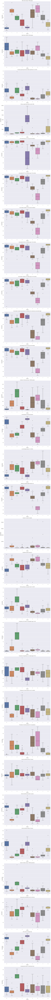

In [145]:
variaveis = df_final.columns[:-3]
fig, axs = plt.subplots(len(variaveis), 1, figsize=(12, 8*len(variaveis)))

# Transformando o array de subplots em uma lista única
axs = axs.flatten()

# Loop sobre as variáveis para criar boxplots
for i, variavel in enumerate(variaveis):
    sns.boxplot(x=df_final['cluster'], y=variavel, data=df_final, ax=axs[i])
    axs[i].set_title(f'{variavel}')
    axs[i].set_xlabel('Cluster')
    axs[i].set_ylabel('Quantidade')

# Ajustando o layout
plt.tight_layout()
plt.show()

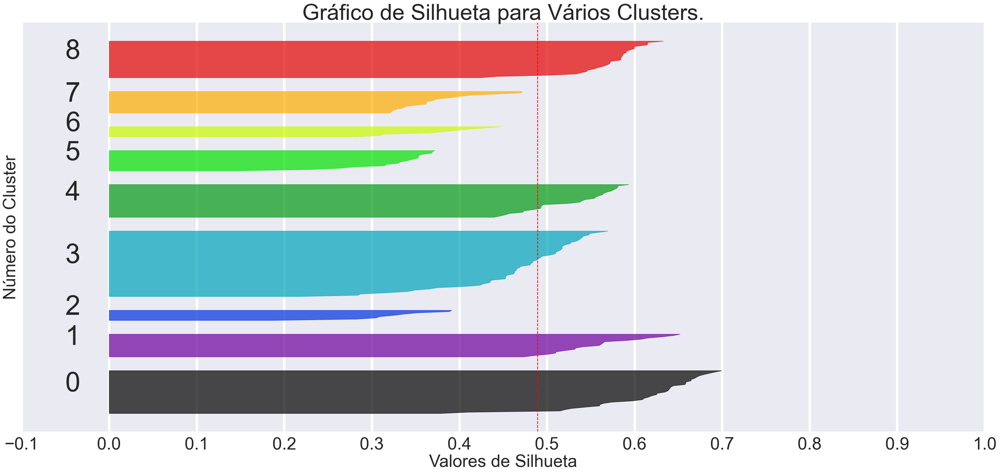

In [146]:
silhouette_avg9 = silhouette_score(df_completa, df_completa['cluster'])


# Calcular as silhuetas para cada ponto
sample_silhouette_values = silhouette_samples(df_completa, df_completa['cluster'])

# Plotar as silhuetas
fig, ax = plt.subplots(1, 1)
n_clusters = 9
y_lower = 10
for i in range(n_clusters):
    # Agregar as silhuetas para amostras pertencentes a um determinado cluster e classificá-las
    ith_cluster_silhouette_values = \
    sample_silhouette_values[df_completa['cluster'] == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

    # Rótulos, no meio
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i), fontsize=55)
    # Calcular o novo y_lower para o próximo plot
    y_lower = y_upper + 10  

ax.set_title("Gráfico de Silhueta para Vários Clusters.", fontsize=45)
ax.set_xlabel("Valores de Silhueta", fontsize=35)
ax.set_ylabel("Número do Cluster", fontsize=35)
ax.xaxis.grid(True, linewidth=5)
ax.yaxis.grid(False)

# A linha vertical para a média da silhueta de todos os valores
ax.axvline(x=silhouette_avg9, color="red", linestyle="--")
ax.tick_params(axis='x', labelsize=35)


ax.set_yticks([])  # Limpar os rótulos
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
plt.show()

In [147]:
print(silhouette_avg9)

0.48957187949900166


In [148]:
ch_score9 = calinski_harabasz_score(df_completa, df_completa['cluster'])

print("Calinski-Harabasz score:", ch_score9)

Calinski-Harabasz score: 489.40437297776316


## Comparativo entre clusters

In [149]:
cluster2 = [silhouette_avg2, ch_score2]
cluster3 = [silhouette_avg3, ch_score3]
cluster4 = [silhouette_avg4, ch_score4]
cluster5 = [silhouette_avg5, ch_score5]
cluster6 = [silhouette_avg6, ch_score6]
cluster7 = [silhouette_avg7, ch_score7]
cluster8 = [silhouette_avg8, ch_score8]
cluster9 = [silhouette_avg9, ch_score9]

In [150]:
df_cluster2 = pd.DataFrame(cluster2, columns = ['Cluster2'], index=['Silhueta', 'CH_score']).T
df_cluster3 = pd.DataFrame(cluster3, columns = ['Cluster3'], index=['Silhueta', 'CH_score']).T
df_cluster4 = pd.DataFrame(cluster4, columns = ['Cluster4'], index=['Silhueta', 'CH_score']).T
df_cluster5 = pd.DataFrame(cluster5, columns = ['Cluster5'], index=['Silhueta', 'CH_score']).T
df_cluster6 = pd.DataFrame(cluster6, columns = ['Cluster6'], index=['Silhueta', 'CH_score']).T
df_cluster7 = pd.DataFrame(cluster7, columns = ['Cluster7'], index=['Silhueta', 'CH_score']).T
df_cluster8 = pd.DataFrame(cluster8, columns = ['Cluster8'], index=['Silhueta', 'CH_score']).T
df_cluster9 = pd.DataFrame(cluster9, columns = ['Cluster9'], index=['Silhueta', 'CH_score']).T

combinados = [df_cluster2, df_cluster3, df_cluster4, df_cluster5, df_cluster6, df_cluster7, df_cluster8, df_cluster9]

merge = pd.concat(combinados)
merge

,Silhueta,CH_score
Cluster2,0.433552,175.904015
Cluster3,0.454874,184.090648
Cluster4,0.389327,155.727269
Cluster5,0.493996,245.559076
Cluster6,0.422204,233.851889
Cluster7,0.482054,329.959970
Cluster8,0.455718,388.617192
Cluster9,0.489572,489.404373


(array([0.38, 0.4 , 0.42, 0.44, 0.46, 0.48, 0.5 ]),
 [Text(0, 0.38, '0.38'),
  Text(0, 0.4, '0.40'),
  Text(0, 0.42, '0.42'),
  Text(0, 0.44, '0.44'),
  Text(0, 0.46, '0.46'),
  Text(0, 0.48, '0.48'),
  Text(0, 0.5, '0.50')])

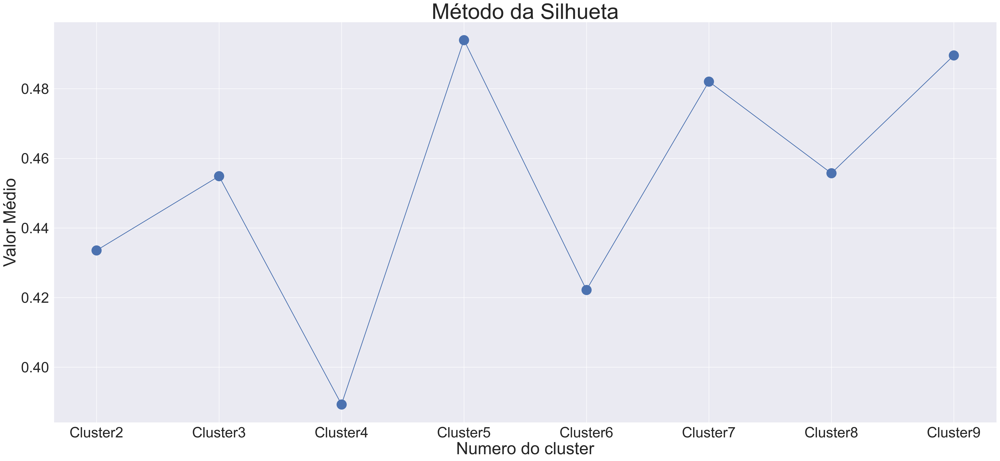

In [151]:
plt.figure(dpi=200)
plt.plot(merge['Silhueta'], '-o', markersize=20)
plt.title('Método da Silhueta', fontsize=45)
plt.xlabel('Numero do cluster', fontsize=35)
plt.xticks(fontsize=30)
plt.ylabel('Valor Médio', fontsize=35)
plt.yticks(fontsize=30)

(array([100., 150., 200., 250., 300., 350., 400., 450., 500., 550.]),
 [Text(0, 100.0, '100'),
  Text(0, 150.0, '150'),
  Text(0, 200.0, '200'),
  Text(0, 250.0, '250'),
  Text(0, 300.0, '300'),
  Text(0, 350.0, '350'),
  Text(0, 400.0, '400'),
  Text(0, 450.0, '450'),
  Text(0, 500.0, '500'),
  Text(0, 550.0, '550')])

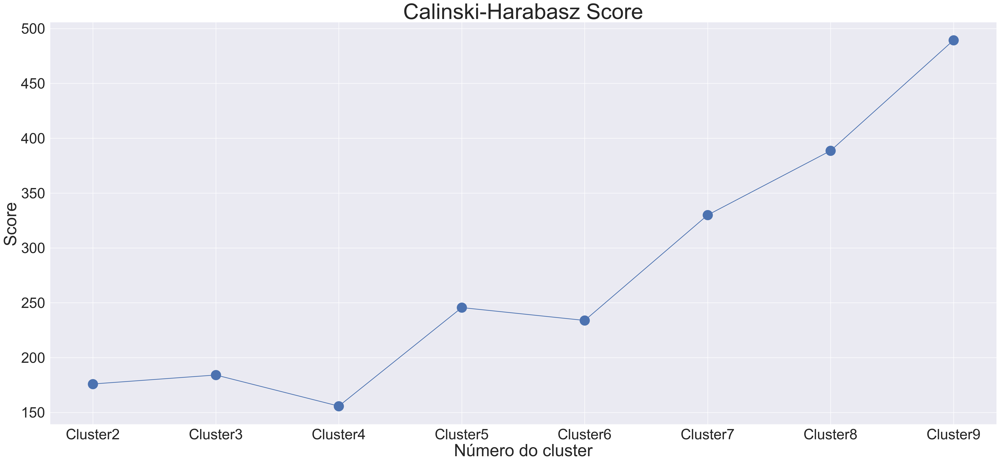

In [152]:
plt.figure(dpi=200)
plt.plot(merge['CH_score'], '-o', markersize=20)
plt.title('Calinski-Harabasz Score', fontsize=45)
plt.xlabel('Número do cluster', fontsize=35)
plt.xticks(fontsize=30)
plt.ylabel('Score', fontsize=35)
plt.yticks(fontsize=30)

In [153]:
# https://medium.com/@kalimarapeleteiro/m%C3%A9tricas-de-agrupamento-coeficiente-de-silhueta-%C3%ADndice-de-davies-bouldin-e-%C3%ADndice-de-9462b87ce676

In [154]:
# Sckit-learn

In [155]:
# Pelo knnimputer?

In [156]:
# sns.boxplot(data=df, x='cluster', y='variável')

In [157]:
idh = pd.read_csv('HDR23-24_Composite_indices_complete_time_series.csv', encoding='latin1')
idh.to_excel('idh_paises.xlsx')